In [1]:
import numpy as np
import pandas as pd
import json
import os
from collections import defaultdict
from itertools import combinations
import pickle

from scipy import stats
from scipy.stats import pearsonr
import pickle
import nibabel as nib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import GroupShuffleSplit

from scipy.stats import ttest_rel

## Uncertainty Map
* Calculated using `calculate_maps.py` script

Comparing the entropy per ROI confirms Dice score results. \
Comparing mean entropy across entire MRI states that: \
Even though the difference in FS and Fast means exists, it is tiny relative to the variability of voxelwise differences as shown by the fraction + Cohen's d.
The two entropy maps are almost indistinguishable at the voxel level.
Statistically, the difference is real (p value) (because of the huge voxel count), but scientifically it is negligible — the two maps are essentially equivalent in entropy.

In [35]:
base_dir = '/mnt/lustre/inesgp/'

stat_subs = { 'Fast Mean': [], 'FS Mean': [], 'Mean Diff': [], 'Cohen d': [], 'Fraction of voxels with Fast > FS': [], 'p value': []}
for sub in os.listdir("/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/2/"):
    if sub in ['0026036_norm.mgz', '0027393_norm.mgz']: continue
    # --- Load ---
    E1 = nib.load(f"{base_dir}/uncertainty_maps_fast/{sub}/uncertainty_map.nii.gz").get_fdata(dtype=np.float32)
    E2 = nib.load(f"{base_dir}/uncertainty_maps_fs/{sub.split('_')[0]}/uncertainty_map.nii.gz").get_fdata(dtype=np.float32)
    mask = np.isfinite(E1) & np.isfinite(E2)

    x = E1[mask].ravel()
    y = E2[mask].ravel()
    diff = x - y

    mean1, mean2 = x.mean(), y.mean()
    median1, median2 = np.median(x), np.median(y)
    frac_E1_greater = np.mean(x > y)  # fraction of voxels where E1 > E2
    mean_diff = diff.mean()

    # Cohen's d for paired data
    d = mean_diff / (diff.std(ddof=1) + 1e-12)

    tstat, p_t = ttest_rel(x, y)

    # Interpretation: 
    # null hypothesis: the voxelwise mean entropy of the two maps is equal).
    # non-null hypothesis: if p < 0.05, one map has significantly higher entropy than the other, on average across voxels.
    print(sub.split('_')[0])
    print(f"Fast mean={mean1:.4f}, FS mean={mean2:.4f}, mean_diff={mean_diff:.4f}, Cohen d={d:.3f}")
    # Interpretation: fraction and Cohen’s d give practical sense of magnitude (d≈0.2 small, 0.5 medium, 0.8 large).
    print(f"Fraction of voxels with E1 > E2: {frac_E1_greater:.3f}")
    print("Paired t-test: t=%.3f p=%.5e" % (tstat, p_t))
    stat_subs['Fast Mean'].append(mean1)
    stat_subs['FS Mean'].append(mean2)
    stat_subs['Mean Diff'].append(mean_diff)
    stat_subs['Cohen d'].append(d)
    stat_subs['p value'].append(p_t)
    stat_subs['Fraction of voxels with Fast > FS'].append(frac_E1_greater)
    print('#' * 50)

0026044
Fast mean=0.0092, FS mean=0.0044, mean_diff=0.0048, Cohen d=0.063
Fraction of voxels with E1 > E2: 0.015
Paired t-test: t=256.685 p=0.00000e+00
##################################################
0025604
Fast mean=0.0086, FS mean=0.0033, mean_diff=0.0054, Cohen d=0.072
Fraction of voxels with E1 > E2: 0.015
Paired t-test: t=293.435 p=0.00000e+00
##################################################
0027236
Fast mean=0.0109, FS mean=0.0040, mean_diff=0.0069, Cohen d=0.078
Fraction of voxels with E1 > E2: 0.019
Paired t-test: t=318.700 p=0.00000e+00
##################################################
0025462
Fast mean=0.0108, FS mean=0.0067, mean_diff=0.0042, Cohen d=0.048
Fraction of voxels with E1 > E2: 0.017
Paired t-test: t=198.262 p=0.00000e+00
##################################################
0025598
Fast mean=0.0095, FS mean=0.0035, mean_diff=0.0060, Cohen d=0.074
Fraction of voxels with E1 > E2: 0.016
Paired t-test: t=304.423 p=0.00000e+00
####################################

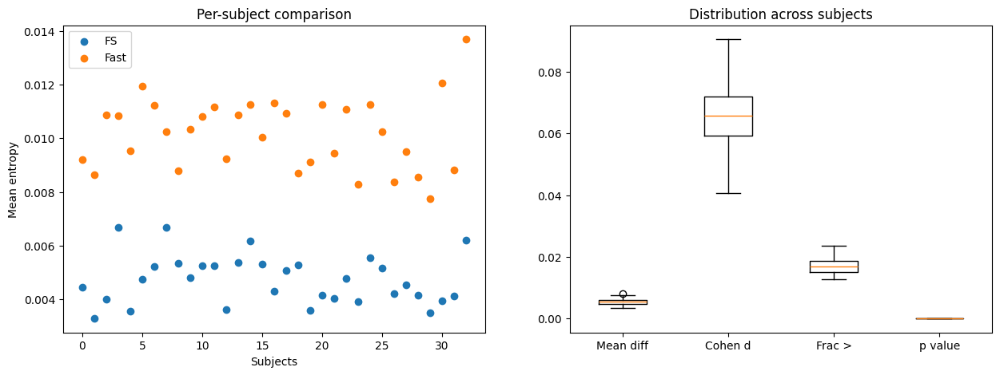

In [36]:
df = pd.DataFrame(stat_subs)
df

fig, axes = plt.subplots(1, 2, figsize=(15,5))
axes[0].scatter(np.arange(len(df["FS Mean"])), df["FS Mean"], label='FS')
axes[0].scatter(np.arange(len(df["Fast Mean"])), df["Fast Mean"], label='Fast')
axes[0].set_xlabel("Subjects")
axes[0].set_ylabel("Mean entropy")
axes[0].set_title("Per-subject comparison"), axes[0].legend()

axes[1].boxplot([df["Mean Diff"], df["Cohen d"], df["Fraction of voxels with Fast > FS"], df['p value']],
            labels=["Mean diff", "Cohen d", "Frac >", "p value"])
axes[1].set_title("Distribution across subjects")

plt.show()


**ROI level comparison** \
If p < 0.05 for ROI r: there is evidence that the two methods systematically differ in entropy in that ROI across subjects. \
If p ≥ 0.05: you cannot reject the hypothesis that the mean entropy values are the same between the two pipelines in that ROI.

In [7]:
# Example using a label image (same space, integer labels)
labels_img = nib.load("/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/2/0003002_norm.mgz/mri/aparc.DKTatlas+aseg.deep.mgz").get_fdata().astype(int)
rois = np.unique(labels_img)
# rois = rois[rois != 0]

In [ ]:
roi_means_E1 = []
roi_means_E2 = []

for sub in os.listdir("/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/2/"):
    if sub in ['0026036_norm.mgz', '0027393_norm.mgz']: continue
    # Load subject maps
    E1 = nib.load(f"{base_dir}/uncertainty_maps_fast/{sub}/uncertainty_map.nii.gz").get_fdata(dtype=np.float32)
    E2 = nib.load(f"{base_dir}/uncertainty_maps_fs/{sub.split('_')[0]}/uncertainty_map.nii.gz").get_fdata(dtype=np.float32)
    mask = np.isfinite(E1) & np.isfinite(E2)

    roi_vals1, roi_vals2 = [], []
    for r in rois:
        rm = (labels_img == r) & mask
        if rm.sum() == 0:
            roi_vals1.append(np.nan)
            roi_vals2.append(np.nan)
        else:
            roi_vals1.append(E1[rm].mean())
            roi_vals2.append(E2[rm].mean())

    roi_means_E1.append(roi_vals1)
    roi_means_E2.append(roi_vals2)

roi_means_E1 = np.array(roi_means_E1)  # shape (n_subjects, n_rois)
roi_means_E2 = np.array(roi_means_E2)
print(roi_means_E2.shape)

(33, 96)
ROI 0: t=19.936, p=1.310e-19
ROI 2: t=8.464, p=1.134e-09
ROI 4: t=2.094, p=4.430e-02
ROI 5: t=-1.508, p=1.415e-01
ROI 7: t=-1.705, p=9.788e-02
ROI 8: t=2.896, p=6.759e-03
ROI 10: t=-1.074, p=2.910e-01
ROI 11: t=2.147, p=3.944e-02
ROI 12: t=-0.749, p=4.591e-01
ROI 13: t=-2.162, p=3.820e-02
ROI 14: t=-1.885, p=6.855e-02
ROI 15: t=-1.957, p=5.912e-02
ROI 16: t=-1.182, p=2.460e-01
ROI 17: t=-6.746, p=1.277e-07
ROI 18: t=-3.544, p=1.237e-03
ROI 24: t=0.200, p=8.424e-01
ROI 26: t=-1.490, p=1.461e-01
ROI 28: t=-6.056, p=9.241e-07
ROI 31: t=-1.219, p=2.317e-01
ROI 41: t=14.541, p=1.187e-15
ROI 43: t=3.367, p=1.993e-03
ROI 44: t=-1.548, p=1.315e-01
ROI 46: t=-0.397, p=6.944e-01
ROI 47: t=8.016, p=3.755e-09
ROI 49: t=-0.062, p=9.510e-01
ROI 50: t=1.536, p=1.345e-01
ROI 51: t=-0.413, p=6.824e-01
ROI 52: t=-1.457, p=1.548e-01
ROI 53: t=-4.589, p=6.538e-05
ROI 54: t=-3.327, p=2.217e-03
ROI 58: t=-1.447, p=1.575e-01
ROI 60: t=-6.849, p=9.529e-08
ROI 63: t=0.874, p=3.886e-01
ROI 77: t=2.529,

In [50]:
# Now run paired t-tests per ROI across subjects
tstats, pvals = ttest_rel(roi_means_E1, roi_means_E2, axis=0, nan_policy="omit")

roi_stats = {'ID': [], 'p-value': []}
for r, t, p in zip(rois, tstats, pvals):
    roi_stats['ID'].append(r)
    roi_stats['p-value'].append(p)
    print(f"ROI {r}: t={t:.3f}, p={p:.3e}")

ROI 0: t=19.936, p=1.310e-19
ROI 2: t=8.464, p=1.134e-09
ROI 4: t=2.094, p=4.430e-02
ROI 5: t=-1.508, p=1.415e-01
ROI 7: t=-1.705, p=9.788e-02
ROI 8: t=2.896, p=6.759e-03
ROI 10: t=-1.074, p=2.910e-01
ROI 11: t=2.147, p=3.944e-02
ROI 12: t=-0.749, p=4.591e-01
ROI 13: t=-2.162, p=3.820e-02
ROI 14: t=-1.885, p=6.855e-02
ROI 15: t=-1.957, p=5.912e-02
ROI 16: t=-1.182, p=2.460e-01
ROI 17: t=-6.746, p=1.277e-07
ROI 18: t=-3.544, p=1.237e-03
ROI 24: t=0.200, p=8.424e-01
ROI 26: t=-1.490, p=1.461e-01
ROI 28: t=-6.056, p=9.241e-07
ROI 31: t=-1.219, p=2.317e-01
ROI 41: t=14.541, p=1.187e-15
ROI 43: t=3.367, p=1.993e-03
ROI 44: t=-1.548, p=1.315e-01
ROI 46: t=-0.397, p=6.944e-01
ROI 47: t=8.016, p=3.755e-09
ROI 49: t=-0.062, p=9.510e-01
ROI 50: t=1.536, p=1.345e-01
ROI 51: t=-0.413, p=6.824e-01
ROI 52: t=-1.457, p=1.548e-01
ROI 53: t=-4.589, p=6.538e-05
ROI 54: t=-3.327, p=2.217e-03
ROI 58: t=-1.447, p=1.575e-01
ROI 60: t=-6.849, p=9.529e-08
ROI 63: t=0.874, p=3.886e-01
ROI 77: t=2.529, p=1.658e

In [55]:
lut = pd.read_csv("/home/inesgp/cnn_training/FastSurfer_ColorLUT.tsv", delimiter='\t')
roi_df = pd.DataFrame(roi_stats)

roi_stat_df = pd.merge(lut, roi_df, how='inner', on=['ID'])

In [59]:
fig = px.scatter(x =roi_stat_df['LabelName'], y=roi_stat_df['p-value']*79)
fig.add_hline(y=0.05, line_dash="dash", line_color="red")
fig.update_yaxes(type="log")
fig.show()

## ROI Volumes
Calculated in  `calculate_roi_vol.py`

In [10]:
def create_subjectID(dataset, subject):
    if dataset == "ADNI_TEST":
        return subject
    elif dataset in ["OAS1", "OAS2"]:
        return subject.split("_MR")[0]
    elif dataset in 'LA5C':
        return f"{dataset}_{subject.split('-')[1]}"
    elif dataset == 'ABIDEI':
        return f"{dataset}_{subject.split('_')[1]}"
    elif dataset == 'MIRIAD':
        return f"{dataset}_{subject.split('_')[1]}"
    else:
        return f"{dataset}_{subject}"


test = pd.read_csv('fastsurfer_small_test.csv')
test["Subject"] = test.apply(lambda row: create_subjectID(row["Dataset"], row["Subject ID"]), axis=1)

train = pd.read_csv('fastsurfer_small_train.csv')
train["Subject"] = train.apply(lambda row: create_subjectID(row["Dataset"], row["Subject ID"]), axis=1)

brain_age = pd.concat([test, train])
brain_age
brain_age.head()

,Dataset,Subject ID,M/F,Age,Diagnosis,Site,State,Subject,Unnamed: 7,Unnamed: 8
0,HCP,103010,F,28.0,NaN,NaN,NaN,HCP_103010,NaN,NaN
1,HCP,103414,F,23.5,NaN,NaN,NaN,HCP_103414,NaN,NaN
2,HCP,104012,F,28.0,NaN,NaN,NaN,HCP_104012,NaN,NaN
3,HCP,105216,M,28.0,NaN,NaN,NaN,HCP_105216,NaN,NaN
4,HCP,108121,F,28.0,NaN,NaN,NaN,HCP_108121,NaN,NaN


### Random Seed Augmented Dataset

In [11]:
tmp_df1 = pd.read_csv('/mnt/lustre/inesgp/roi_volumes.csv')
df1 = (
    tmp_df1.groupby("Subject", group_keys=False)
      .apply(lambda g: g.loc[:, g.sum() != 0])
)
df1 = df1.drop(df1.loc[df1['Subject'] == 'HCP_211417'].index)
# df1 = pd.DataFrame({})

tmp_df2 = pd.read_csv('/home/inesgp/cnn_training/roi_volumes_train_v2.csv')
df2 = (
    tmp_df2.groupby("Subject", group_keys=False)
      .apply(lambda g: g.loc[:, g.sum() != 0])
)
# df2 = pd.DataFrame({})


df = pd.concat([df1, df2])
df["Subject"] = df["Subject"].apply(lambda x: str(x).split(".")[0])


feature_rows = []
target = {}
subjectids = []

for sub in df['Subject'].unique():
    if sub in ['OAS2_0117', 'MIRIAD_221', 'MIRIAD_221_5'] or 'sub' in sub: continue #subject appears in multiple times as multiple sessions
    # print(sub)
    feature_rows.append( df.loc[df['Subject'] == sub].drop(columns=['Subject']) )
    target[sub] = [brain_age.loc[brain_age['Subject'] == sub]['Age'].item()] * 10
    subjectids.append( [sub] * 10 )


feature_rows = np.array(feature_rows)
y = np.array(list(target.values()))
target = pd.DataFrame(target)


/tmp/ipykernel_3082133/2032132149.py:4: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

/tmp/ipykernel_3082133/2032132149.py:12: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



### SVM

In [8]:
reps = {}

for n in range(1,11):
    reps[n] = []
    groups = list(target.columns)  # subject IDs, shape (280,)
    groups = np.repeat(groups, n) 
    combo_indices = list(combinations(range(10), n))
    combinations_list_X = [feature_rows[:, list(pair), :] for pair in combo_indices]
    combinations_list_y = [y[:, list(pair)] for pair in combo_indices]

    for x_rep, y_rep in zip(combinations_list_X, combinations_list_y):


        X_flat = x_rep.reshape(-1, 95)       # (280*N, 95)
        y_flat = y_rep.reshape(-1)                   # (280*N, )

        # print(X_flat.shape, y_flat.shape)

        gss = GroupShuffleSplit(n_splits=1, test_size=0.1, random_state=42)
        train_idx, test_idx = next(gss.split(X_flat, y_flat, groups=groups))

        # Use indices to slice arrays
        X_train, X_test = X_flat[train_idx], X_flat[test_idx]
        y_train, y_test = y_flat[train_idx], y_flat[test_idx]
        # subjects_train, subjects_test = groups[train_idx], groups[test_idx]

        # Support Vector Regression
        # Common starting hyperparameters: RBF kernel, C ~ 1-100, epsilon ~ 0.1
        svr = SVR(kernel="rbf", C=100, epsilon=0.1)
        svr.fit(X_train, y_train)

        # Evaluate
        y_pred = svr.predict(X_train)
        mae = mean_absolute_error(y_train, y_pred)
        # print(f"Train MAE: {mae:.2f} years")

        # Evaluate
        y_pred = svr.predict(X_test)
        mae = mean_absolute_error(y_test, y_pred)
        print(f"Test MAE: {mae:.2f} years")
        reps[n].append(mae)
    #     break
    # break

pickle.dump(reps, open('/home/inesgp/cnn_training/mae_reps_train_svm.pkl', 'wb'))

Test MAE: 9.31 years
Test MAE: 9.24 years
Test MAE: 9.20 years
Test MAE: 9.11 years
Test MAE: 9.12 years
Test MAE: 9.13 years
Test MAE: 9.22 years
Test MAE: 9.26 years
Test MAE: 9.20 years
Test MAE: 9.39 years
Test MAE: 9.57 years
Test MAE: 9.51 years
Test MAE: 9.45 years
Test MAE: 9.45 years
Test MAE: 9.51 years
Test MAE: 9.49 years
Test MAE: 9.44 years
Test MAE: 9.42 years
Test MAE: 9.50 years
Test MAE: 9.48 years
Test MAE: 9.44 years
Test MAE: 9.43 years
Test MAE: 9.49 years
Test MAE: 9.49 years
Test MAE: 9.43 years
Test MAE: 9.43 years
Test MAE: 9.53 years
Test MAE: 9.42 years
Test MAE: 9.40 years
Test MAE: 9.45 years
Test MAE: 9.45 years
Test MAE: 9.39 years
Test MAE: 9.38 years
Test MAE: 9.49 years
Test MAE: 9.37 years
Test MAE: 9.43 years
Test MAE: 9.41 years
Test MAE: 9.36 years
Test MAE: 9.35 years
Test MAE: 9.42 years
Test MAE: 9.40 years
Test MAE: 9.40 years
Test MAE: 9.35 years
Test MAE: 9.32 years
Test MAE: 9.39 years
Test MAE: 9.46 years
Test MAE: 9.38 years
Test MAE: 9.3

In [20]:
reps = pickle.load(open('/home/inesgp/cnn_training/mae_reps_train_svm.pkl', 'rb'))

In [ ]:
df = {'repetition': [], 'MAE': [], 'subset_size': []}
for n in reps:

    # if n != 1 and n != 10:
    #     continue

    # df['repetition'].append( [n] * len(reps[n]) )
    # df['MAE'].append( reps[n] * len(reps[n]) )
    # df['subset_size'].append( [len(reps[n])] * len(reps[n])  )
    df['repetition'].append(n) 
    df['MAE'].append(np.mean(reps[n]) )
    df['subset_size'].append( len(reps[n]) )


df = pd.DataFrame(df)
df

from scipy.stats import linregress

slope, intercept, r_value, p_value, std_err = linregress(df['repetition'], df['MAE'], alternative='two-sided', )
x_vals = np.linspace(min(df['repetition']), max(df['repetition']), 100)
y_vals = slope * x_vals + intercept


In [22]:
# Assuming reps is a dictionary: {rep_number: [values]}
data = []
for n, values in reps.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df = pd.DataFrame(data)

# Box + swarm plot
fig = px.box(
    df, 
    x="Repetition", 
    y="MAE", 
    points="all",   # adds swarm plot (jittered individual points)
    labels={"Repetition": "Repetitions", "MAE": "MAE (years)"}
)

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash')
))

fig.add_annotation(
    x = max(x_vals),
    y=max(y_vals),
    text="",
    showarrow=False,
    font=dict(size=12, color='red')
)

fig.add_annotation(
    x = 1,
    y=1,
    text=f"Pearson R value: {r_value:.3f}, p-value: {p_value:.3e}<br>y = {slope:.3f}x + {intercept:.3f}",
    showarrow=False,
    xref='paper',
    yref='paper',
    xanchor='right',
    yanchor='top',
    font=dict(size=16, color='red')
)

fig.update_layout(
    width=1500, height=400,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    showlegend=False
)

fig.show()
fig.write_image('/home/inesgp/cnn_training/data_aug_corr_test+train_svm.pdf', engine="kaleido", format='pdf')


### Random Forest

In [106]:
reps = {}

for n in range(1,11):
    reps[n] = []
    groups = list(target.columns)  # subject IDs, shape (280,)
    groups = np.repeat(groups, n) 
    combo_indices = list(combinations(range(10), n))
    combinations_list_X = [feature_rows[:, list(pair), :] for pair in combo_indices]
    combinations_list_y = [y[:, list(pair)] for pair in combo_indices]

    for x_rep, y_rep in zip(combinations_list_X, combinations_list_y):


        X_flat = x_rep.reshape(-1, 95)       # (280*N, 95)
        y_flat = y_rep.reshape(-1)                   # (280*N, )

        # print(X_flat.shape, y_flat.shape)

        gss = GroupShuffleSplit(n_splits=1, test_size=0.1, random_state=42)
        train_idx, test_idx = next(gss.split(X_flat, y_flat, groups=groups))

        # Use indices to slice arrays
        X_train, X_test = X_flat[train_idx], X_flat[test_idx]
        y_train, y_test = y_flat[train_idx], y_flat[test_idx]
        # subjects_train, subjects_test = groups[train_idx], groups[test_idx]

        # Random forest regression
        rf = RandomForestRegressor(max_depth=20, max_features='sqrt', min_samples_leaf=4, min_samples_split=2, n_estimators=200, random_state=42)
        rf.fit(X_train, y_train)

        # Evaluate
        y_pred = rf.predict(X_train)
        mae = mean_absolute_error(y_train, y_pred)
        # print(f"Train MAE: {mae:.2f} years")

        # Evaluate
        y_pred = rf.predict(X_test)
        mae = mean_absolute_error(y_test, y_pred)
        print(f"Test MAE: {mae:.2f} years")
        reps[n].append(mae)

pickle.dump(reps, open('/home/inesgp/cnn_training/mae_reps_train_v2.pkl', 'wb'))

Test MAE: 8.17 years
Test MAE: 8.32 years
Test MAE: 8.25 years
Test MAE: 8.18 years
Test MAE: 8.54 years
Test MAE: 8.20 years
Test MAE: 8.58 years
Test MAE: 8.34 years
Test MAE: 8.41 years
Test MAE: 8.48 years
Test MAE: 8.13 years
Test MAE: 7.70 years
Test MAE: 7.83 years
Test MAE: 7.92 years
Test MAE: 7.87 years
Test MAE: 8.03 years
Test MAE: 7.79 years
Test MAE: 7.95 years
Test MAE: 7.79 years
Test MAE: 7.88 years
Test MAE: 7.97 years
Test MAE: 7.99 years
Test MAE: 7.89 years
Test MAE: 8.03 years
Test MAE: 7.83 years
Test MAE: 7.86 years
Test MAE: 8.10 years
Test MAE: 7.73 years
Test MAE: 7.87 years
Test MAE: 7.85 years
Test MAE: 7.86 years
Test MAE: 7.95 years
Test MAE: 8.08 years
Test MAE: 8.06 years
Test MAE: 7.63 years
Test MAE: 7.94 years
Test MAE: 7.86 years
Test MAE: 7.76 years
Test MAE: 7.87 years
Test MAE: 7.92 years
Test MAE: 7.64 years
Test MAE: 8.09 years
Test MAE: 7.63 years
Test MAE: 7.83 years
Test MAE: 7.97 years
Test MAE: 7.98 years
Test MAE: 8.00 years
Test MAE: 7.8

In [12]:
# reps = pickle.load(open('/home/inesgp/cnn_training/mae_reps.pkl', 'rb'))
reps = pickle.load(open('/home/inesgp/cnn_training/mae_reps_train_v2.pkl', 'rb'))

In [13]:
df = {'repetition': [], 'MAE': [], 'subset_size': []}
for n in reps:

    # if n != 1 and n != 10:
    #     continue

    # df['repetition'].append( [n] * len(reps[n]) )
    # df['MAE'].append( reps[n] * len(reps[n]) )
    # df['subset_size'].append( [len(reps[n])] * len(reps[n])  )
    df['repetition'].append(n) 
    df['MAE'].append(np.mean(reps[n]) )
    df['subset_size'].append( len(reps[n]) )


df = pd.DataFrame(df)
df

from scipy.stats import linregress

slope, intercept, r_value, p_value, std_err = linregress(df['repetition'], df['MAE'], alternative='two-sided', )
x_vals = np.linspace(min(df['repetition']), max(df['repetition']), 100)
y_vals = slope * x_vals + intercept


In [14]:
reps_svm = pickle.load(open('/home/inesgp/cnn_training/mae_reps_train_svm.pkl', 'rb'))
df = {'repetition': [], 'MAE': [], 'subset_size': []}
for n in reps_svm:
    df['repetition'].append(n) 
    df['MAE'].append(np.mean(reps_svm[n]) )
    df['subset_size'].append( len(reps_svm[n]) )


df = pd.DataFrame(df)
df

from scipy.stats import linregress

slope_svm, intercept_svm, r_value_svm, p_value_svm, std_err_svm = linregress(df['repetition'], df['MAE'], alternative='two-sided', )
x_vals_svm = np.linspace(min(df['repetition']), max(df['repetition']), 100)
y_vals_svm = slope_svm * x_vals_svm + intercept_svm


In [41]:
# Assuming reps is a dictionary: {rep_number: [values]}
data = []
for n, values in reps.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df = pd.DataFrame(data)
df["Model"] = "Random Forest"

data = []
for n, values in reps_svm.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df_svm = pd.DataFrame(data)

# Box + swarm plot
fig = px.box(
    df, 
    x="Repetition", 
    y="MAE", 
    points="all",   # adds swarm plot (jittered individual points)
    labels={"Repetition": "Repetitions", "MAE": "MAE (years)"},
    color_discrete_sequence=['slateblue'],
    color='Model'
)

fig.add_trace(
    go.Box(
        x=df_svm["Repetition"],   # categorical/grouping variable
        y=df_svm["MAE"],          # numeric values
        boxpoints="all",          # equivalent to points="all" in px.box
        jitter=0.5,               # spread out the points a little
        pointpos=-1.75,               # position of scatter points relative to box
        marker=dict(color="green"),       # color of the individual points
        line=dict(color="green"),         # color of box edges
        fillcolor="lightgreen", 
        opacity=0.6,
        name='SVM'
    )
)
#px.colors.qualitative.Plotly[2]



fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash'),
    showlegend=False
))

fig.add_trace(go.Scatter(
    x=x_vals_svm,
    y=y_vals_svm,
    mode='lines',
    line=dict(color='red', dash='dash'),
    showlegend=False
))

# fig.add_annotation(
#     x = max(x_vals),
#     y=max(y_vals),
#     text="",
#     showarrow=False,
#     font=dict(size=12, color='red'),
# )

# fig.add_annotation(
#     x = 1,
#     y=1,
#     text=f"Pearson R value: {r_value:.3f}, p-value: {p_value:.3e}<br>y = {slope:.3f}x + {intercept:.3f}",
#     showarrow=False,
#     xref='paper',
#     yref='paper',
#     xanchor='right',
#     yanchor='bottom',
#     font=dict(size=16, color='red')
# )

# fig.add_annotation(
#     x = 1,
#     y=1,
#     text=f"Pearson R value: {r_value_svm:.3f}, p-value: {p_value_svm:.3e}<br>y = {slope_svm:.3f}x + {intercept_svm:.3f}",
#     showarrow=False,
#     xref='paper',
#     yref='paper',
#     xanchor='right',
#     yanchor='top',
#     font=dict(size=16, color='red')
# )

print(f"SVM ", f"Pearson R value: {r_value_svm:.3f}, p-value: {p_value_svm:.3e}<br>y = {slope_svm:.3f}x + {intercept_svm:.3f}")
print(f"RF ", f"Pearson R value: {r_value:.3f}, p-value: {p_value:.3e}<br>y = {slope:.3f}x + {intercept:.3f}")

fig.update_layout(
    width=1500, height=400,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    showlegend=True
)

fig.show()
fig.write_image('/home/inesgp/cnn_training/data_aug_corr_models.pdf', engine="kaleido", format='pdf')


SVM  Pearson R value: -0.803, p-value: 5.154e-03<br>y = -0.072x + 9.622
RF  Pearson R value: -0.830, p-value: 2.932e-03<br>y = -0.071x + 8.097


In [6]:
# Assuming reps is a dictionary: {rep_number: [values]}
data = []
for n, values in reps.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df = pd.DataFrame(data)

# Box + swarm plot
fig = px.box(
    df, 
    x="Repetition", 
    y="MAE", 
    points="all",   # adds swarm plot (jittered individual points)
    labels={"Repetition": "Repetitions", "MAE": "MAE (years)"}
)

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash')
))

fig.add_annotation(
    x = max(x_vals),
    y=max(y_vals),
    text="",
    showarrow=False,
    font=dict(size=12, color='red')
)

fig.add_annotation(
    x = 1,
    y=1,
    text=f"Pearson R value: {r_value:.3f}, p-value: {p_value:.3e}<br>y = {slope:.3f}x + {intercept:.3f}",
    showarrow=False,
    xref='paper',
    yref='paper',
    xanchor='right',
    yanchor='top',
    font=dict(size=16, color='red')
)

fig.update_layout(
    width=1500, height=400,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    showlegend=False
)

fig.show()
fig.write_image('/home/inesgp/cnn_training/data_aug_corr_test+train.pdf', engine="kaleido", format='pdf')


In [125]:
# Assuming reps is a dictionary: {rep_number: [values]}
data = []
for n, values in reps.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df = pd.DataFrame(data)

# Box + swarm plot
fig = px.box(
    df, 
    x="Repetition", 
    y="MAE", 
    points="all",   # adds swarm plot (jittered individual points)
    labels={"Repetition": "Repetitions", "MAE": "MAE (years)"}
)

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash')
))

fig.add_annotation(
    x = max(x_vals),
    y=max(y_vals),
    text="",
    showarrow=False,
    font=dict(size=14, color='red')
)

fig.add_annotation(
    x = 1,
    y=1,
    text=f"Pearson R value: {r_value:.3f}, p-value: {p_value:.3e}<br>y = {slope:.3f}x + {intercept:.3f}",
    showarrow=False,
    xref='paper',
    yref='paper',
    xanchor='right',
    yanchor='top',
    font=dict(size=16, color='red')
)

fig.update_layout(
    width=1500, height=400,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    showlegend=False
)

fig.show()
fig.write_image('/home/inesgp/cnn_training/data_aug_corr_test.pdf', engine="kaleido", format='pdf')


In [27]:
# Define model
rf = RandomForestRegressor(random_state=42)

# Parameter grid
param_grid = {
    'n_estimators': [100, 200, 500],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt', 'log2']
}

# Grid search
grid_search = GridSearchCV(
    estimator=rf,
    param_grid=param_grid,
    cv=5,
    n_jobs=-1,
    scoring='neg_mean_squared_error'
)

grid_search.fit(X_train, y_train)

print("Best parameters:", grid_search.best_params_)
print("Best score:", -grid_search.best_score_)


/home/inesgp/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:540: FitFailedWarning: 
540 fits failed out of a total of 1620.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
137 fits failed with the following error:
Traceback (most recent call last):
  File "/home/inesgp/.local/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/home/inesgp/.local/lib/python3.11/site-packages/sklearn/base.py", line 1466, in wrapper
    estimator._validate_params()
  File "/home/inesgp/.local/lib/python3.11/site-packages/sklearn/base.py", line 666, in _validate_params
    validate_parameter_constraints(
  File "/home/inesgp/.l

Best parameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 100}
Best score: 105.21021052169506


In [5]:
reps = {}
data = {}

for n in [1,10]:
    reps[n] = []
    data[n] = {'y_pred': [], 'y_test': []}
    groups = list(target.columns)  # subject IDs, shape (280,)
    groups = np.repeat(groups, n) 
    combo_indices = list(combinations(range(10), n))
    combinations_list_X = [feature_rows[:, list(pair), :] for pair in combo_indices]
    combinations_list_y = [y[:, list(pair)] for pair in combo_indices]

    for x_rep, y_rep in zip(combinations_list_X, combinations_list_y):


        X_flat = x_rep.reshape(-1, 95)       # (280*N, 95)
        y_flat = y_rep.reshape(-1)                   # (280*N, )

        # print(X_flat.shape, y_flat.shape)

        gss = GroupShuffleSplit(n_splits=1, test_size=0.1, random_state=42)
        train_idx, test_idx = next(gss.split(X_flat, y_flat, groups=groups))

        # Use indices to slice arrays
        X_train, X_test = X_flat[train_idx], X_flat[test_idx]
        y_train, y_test = y_flat[train_idx], y_flat[test_idx]
        # subjects_train, subjects_test = groups[train_idx], groups[test_idx]

        # Random forest regression
        rf = RandomForestRegressor(max_depth=20, max_features='sqrt', min_samples_leaf=4, min_samples_split=2, n_estimators=200, random_state=42)
        rf.fit(X_train, y_train)

        # Evaluate
        y_pred = rf.predict(X_train)
        mae = mean_absolute_error(y_train, y_pred)
        # print(f"Train MAE: {mae:.2f} years")

        # Evaluate
        y_pred = rf.predict(X_test)
        mae = mean_absolute_error(y_test, y_pred)
        print(f"Test MAE: {mae:.2f} years")
        reps[n].append(mae)

        data[n]['y_pred'].append(y_pred)
        data[n]['y_test'].append(y_test)

# pickle.dump(reps, open('/home/inesgp/cnn_training/mae_reps_train.pkl', 'wb'))

Test MAE: 8.10 years
Test MAE: 8.42 years
Test MAE: 8.37 years
Test MAE: 8.05 years
Test MAE: 8.23 years
Test MAE: 8.14 years
Test MAE: 8.12 years
Test MAE: 8.08 years
Test MAE: 8.34 years
Test MAE: 8.47 years
Test MAE: 7.40 years


In [ ]:
np.mean(reps[1]), reps[1]

3,7,0,6,5,4,8,2,1,9

(8.232351164449788,
 [8.09723417529614,
  8.423541119823293,
  8.365833477980939,
  8.049731353593861,
  8.227056393380904,
  8.141455729343035,
  8.123198094512611,
  8.084345455150865,
  8.337906583610758,
  8.473209261805483])

In [26]:
np.array(data[1]['y_test'])[:,0], np.array(data[1]['y_test']).shape

(array([23., 23., 23., 23., 23., 23., 23., 23., 23., 23.]), (10, 41))

In [57]:
# y_test = data[1]['y_test'][1]
# y_pred = data[1]['y_pred'][1]
# mae = mean_absolute_error(y_test, y_pred)

df = {'y_test':[], 'y_pred': [], 'sub': []}
for y_type, values in data[1].items():
    for n in range(np.array(data[1]['y_test']).shape[1]):
        df[y_type].append(np.array(data[1][y_type])[:,n])
        if y_type == 'y_test': df['sub'].append([n] * 10)

df['y_test'] = np.array(df['y_test']).flatten()
df['y_pred'] = np.array(df['y_pred']).flatten()
df['sub'] = np.array(df['sub']).flatten()

df1 = pd.DataFrame(df)

df2 = pd.DataFrame({'y_pred': np.array(data[10]['y_pred']).flatten(), 
                    'y_test': np.array(data[10]['y_test']).flatten()+0.5, 
                    'sub': np.array([ [i]*10 for i in range(41)]).flatten()} )

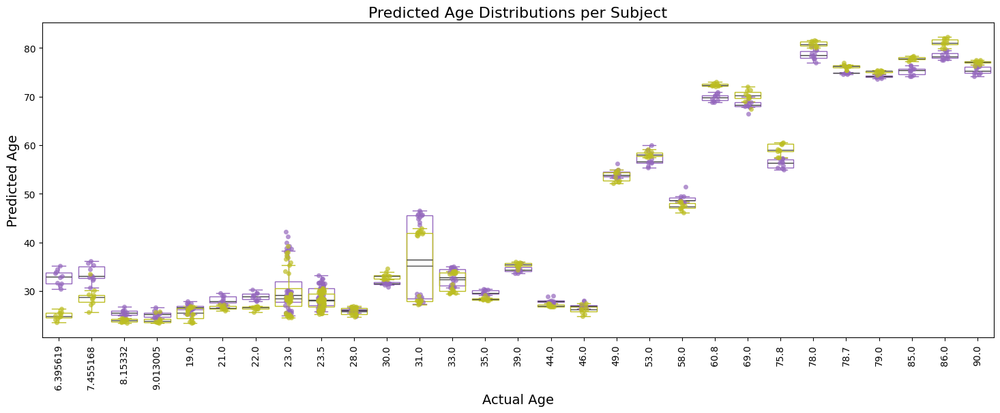

In [54]:
import seaborn as sns
import matplotlib.pyplot as plt

df1["y_test"] = df1["y_test"].astype(float)
df2["y_test"] = df2["y_test"].astype(float)

plt.figure(figsize=(18, 6))
sns.boxplot(x="y_test", y="y_pred", data=df1, dodge=False, 
            boxprops=dict(facecolor=(0,0,0,0), edgecolor="tab:purple"),  # transparent fill, blue edges
            whiskerprops=dict(color="tab:purple"),
            capprops=dict(color="tab:purple"),
            # medianprops=dict(color="tab:purple"),
            showfliers=False)
sns.stripplot(x="y_test", y="y_pred", data=df1, dodge=False,  color="tab:purple", alpha=0.7, legend=False)

sns.boxplot(x="y_test", y="y_pred", data=df2, dodge=False, boxprops=dict(facecolor=(0,0,0,0), edgecolor="tab:olive"),  # transparent fill, blue edges
            whiskerprops=dict(color="tab:olive"),
            capprops=dict(color="tab:olive"),
            # medianprops=dict(color="tab:olive"), 
            showfliers=False, legend=False)
sns.stripplot(x="y_test", y="y_pred", data=df2, dodge=False, color="tab:olive", alpha=0.7, legend=False)

plt.xlabel("Actual Age", fontsize=14)
plt.ylabel("Predicted Age", fontsize=14)
plt.title("Predicted Age Distributions per Subject", fontsize=16)
# plt.xlim(0, 90)
# plt.xticks(range(0, 91, 5))  # optional: tick marks every 5 years
plt.xticks(rotation=90)
plt.show()


In [53]:
import plotly.graph_objects as go

fig = go.Figure()

# df1 boxplots (shifted slightly left)
fig.add_trace(go.Box(
    x=[val - 0.15 for val in df1["y_test"]],  # shift box itself
    y=df1["y_pred"],
    name="df1",
    boxpoints="all",
    jitter=0.5,
    marker=dict(color="purple"),
    line=dict(color="purple"),
    fillcolor="rgba(128, 0, 128, 0.3)"
))

# df2 boxplots (shifted slightly right)
fig.add_trace(go.Box(
    x=[val + 0.15 for val in df2["y_test"]],  # shift box itself
    y=df2["y_pred"],
    name="df2",
    boxpoints="all",
    jitter=0.5,
    marker=dict(color="green"),
    line=dict(color="green"),
    fillcolor="rgba(0, 128, 0, 0.3)"
))

# Layout
fig.update_layout(
    width=1400,
    height=600,
    xaxis=dict(title="Actual Age"),
    yaxis=dict(title="Predicted Age"),
    showlegend=True
)

fig.show()


In [46]:
import plotly.express as px

fig1 = px.box(
    df1,
    x="y_test",
    y="y_pred",
    # color="sub",
    points="all",  # show all predictions
    labels={"y_test": "Actual Age", "y_pred": "Predicted Age"},
    title="Predicted Age Distribution per Subject"
)

fig2 = px.box(
    df2,
    x="y_test",
    y="y_pred",
    # color="sub",
    points="all",  # show all predictions
    labels={"y_test": "Actual Age", "y_pred": "Predicted Age"},
    title="Predicted Age Distribution per Subject"
)



fig = go.Figure()

for trace in fig1.data: fig.add_trace(trace)
for trace in fig2.data: fig.add_trace(trace)

fig.update_layout(
    width=1400,
    height=600,
    xaxis=dict(title="Actual Age"),
    yaxis=dict(title="Predicted Age"),
    showlegend=False  # turn off legend since too many subs
)

fig.show()


In [63]:
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=df1["y_test"], 
    y=df1["y_pred"], 
    mode='markers',
    marker=dict(color='purple'),
    opacity=0.75,
    # color='sub',
    # points="all",   # adds swarm plot (jittered individual points)
    # hover_data=['sub'],
    # labels={"y_test": "Actual Age", "y_pred": "Predicted Age"},
    name='1 Repetition'
))

fig.add_trace(go.Scatter(
    x=df2["y_test"], 
    y=df2["y_pred"], 
    # color='sub',
    mode='markers',
    marker=dict(color='green'),
    opacity=0.75,
    # points="all",   # adds swarm plot (jittered individual points)
    # hover_data=['sub'],
    # labels={"y_test": "Actual Age", "y_pred": "Predicted Age"},
    name='10 Repetitions'
))


# for trace in fig1.data: fig.add_trace(trace)
# for trace in fig2.data: fig.add_trace(trace)

min_val = min(df1['y_test'].min(), df1['y_pred'].min())
max_val = max(df1['y_test'].max(), df1['y_pred'].max())

fig.add_trace(go.Scatter(
    x = [min_val, max_val],
    y = [min_val, max_val],
    mode='lines',
    name='Perfect Prediction',
    line=dict(color='black', dash='dash')
))

fig.update_layout(
    width=1200, height=600,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16), showgrid=False),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16), showgrid=False),
    xaxis_title='Actual Age',
    yaxis_title='Predicted Age',
    # legend_title='Subject',
    font=dict(size=16),
    title_font=dict(size=18),
    # template='plotly_white',
    # plot_bgcolor='white',
    # paper_bgcolor='white'
)

fig.show()
fig.write_image('/home/inesgp/cnn_training/actual_pred_age_train+test.pdf', engine="kaleido", format='pdf')


In [ ]:
# Assuming reps is a dictionary: {rep_number: [values]}
data = []
for n, values in reps.items():
    for v in values:
        data.append({"Repetition": n, "MAE": v})

df = pd.DataFrame(data)

# Box + swarm plot
fig = px.box(
    df, 
    x="Repetition", 
    y="MAE", 
    points="all",   # adds swarm plot (jittered individual points)
    labels={"Repetition": "Repetitions", "MAE": "MAE (years)"}
)

fig.add_trace(go.Scatter(
    x=x_vals,
    y=y_vals,
    mode='lines',
    line=dict(color='red', dash='dash')
))

fig.add_annotation(
    x = max(x_vals),
    y=max(y_vals),
    text=f"y= = {slope:.3f}x + {intercept:.3f}",
    showarrow=False,
    xanchor='right',
    font=dict(size=12, color='red')
)

fig.update_layout(
    width=1500, height=400,
    xaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
    yaxis=dict(title_font=dict(size=20), tickfont=dict(size=16)),
)

fig.show()


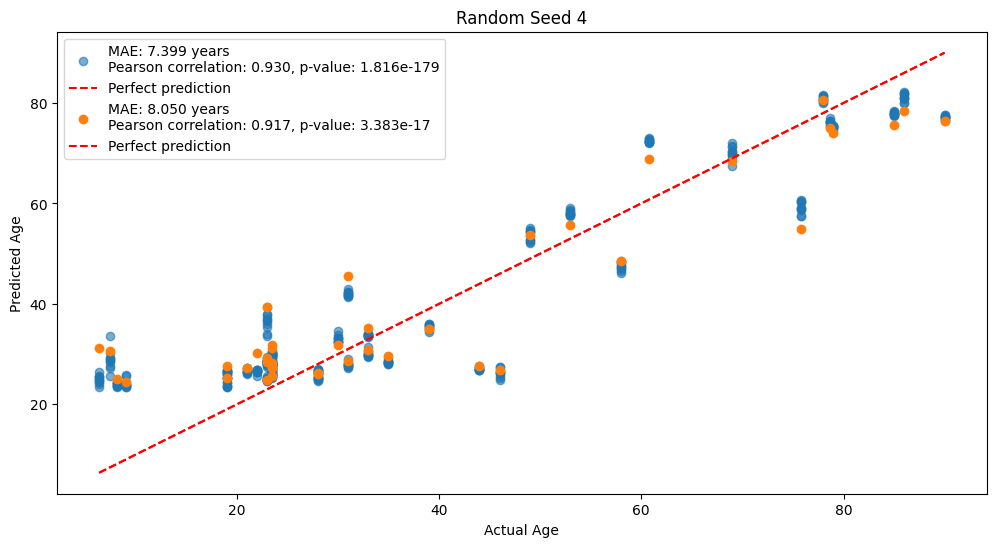

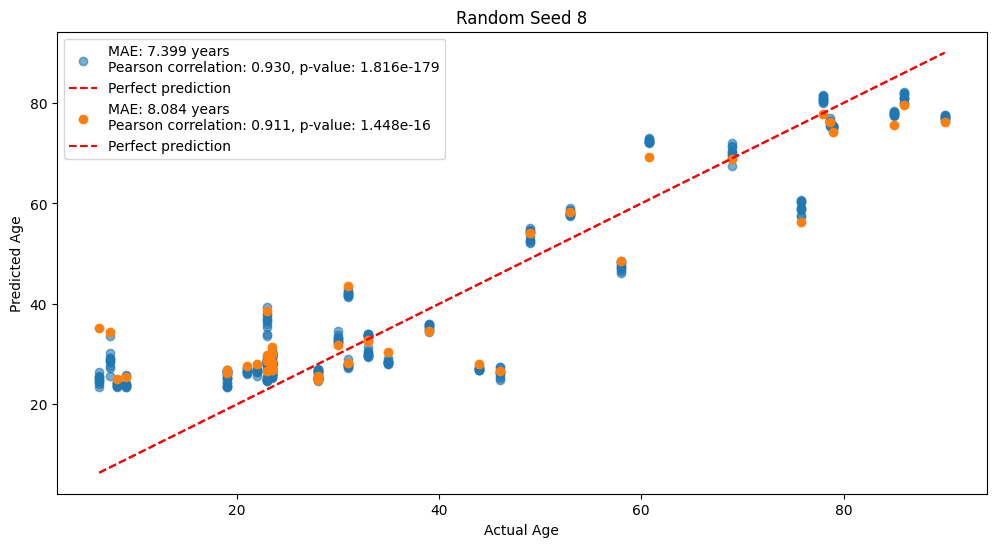

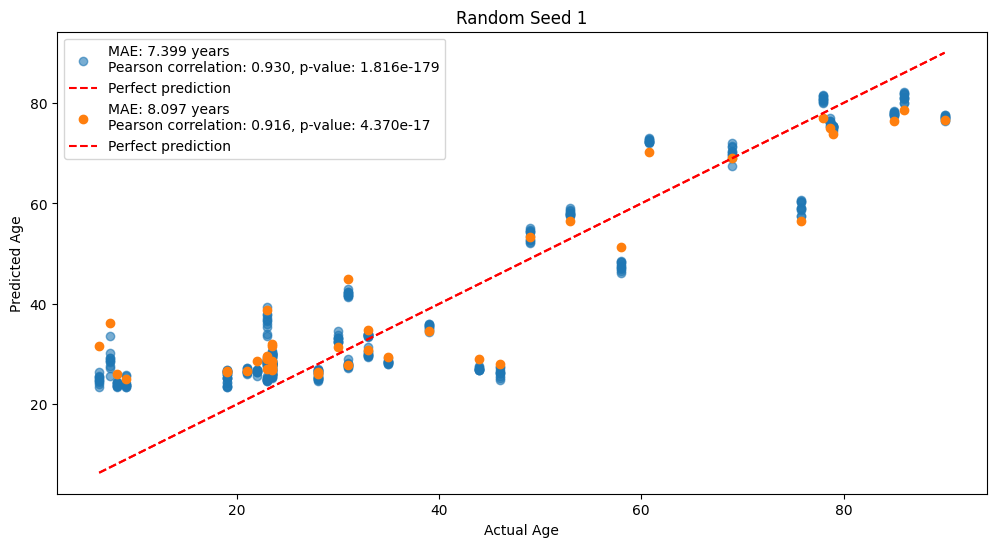

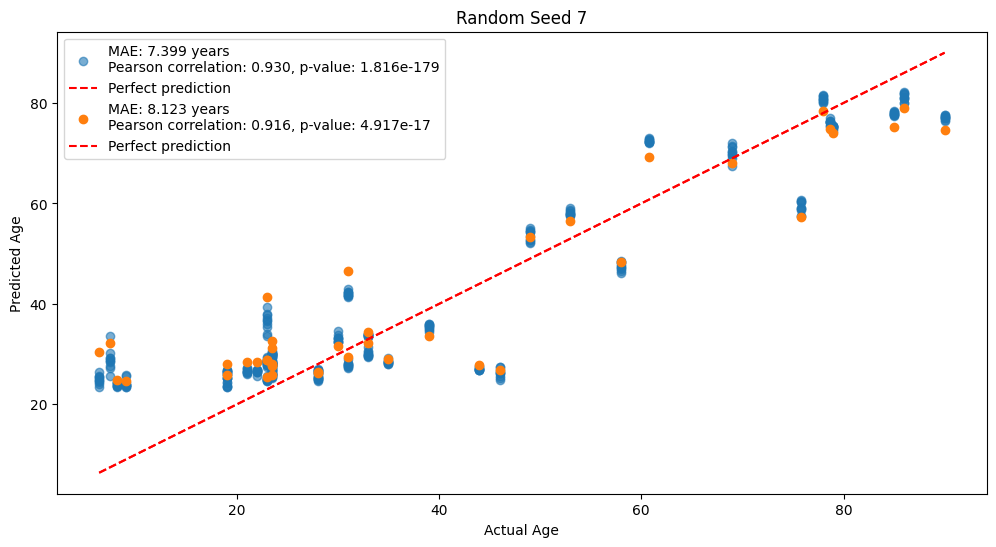

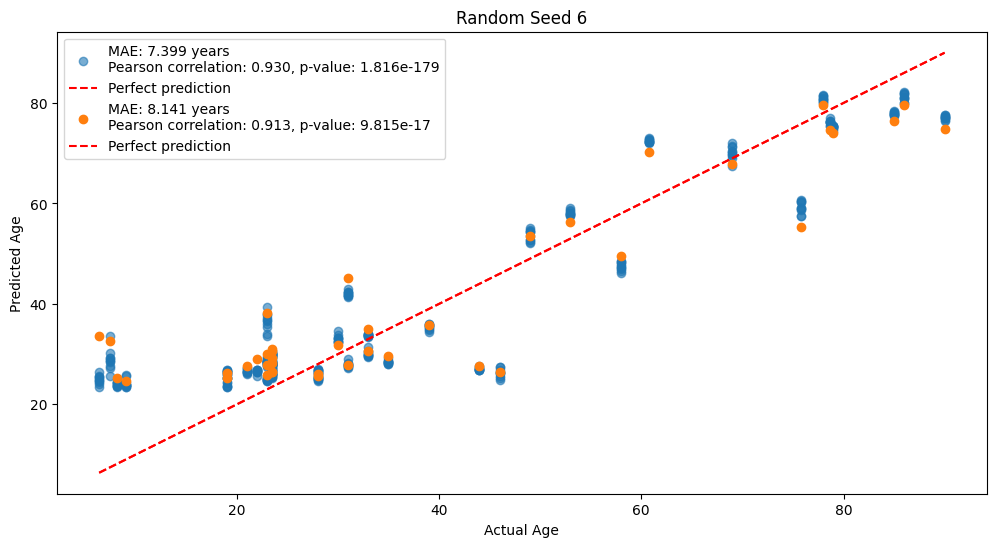

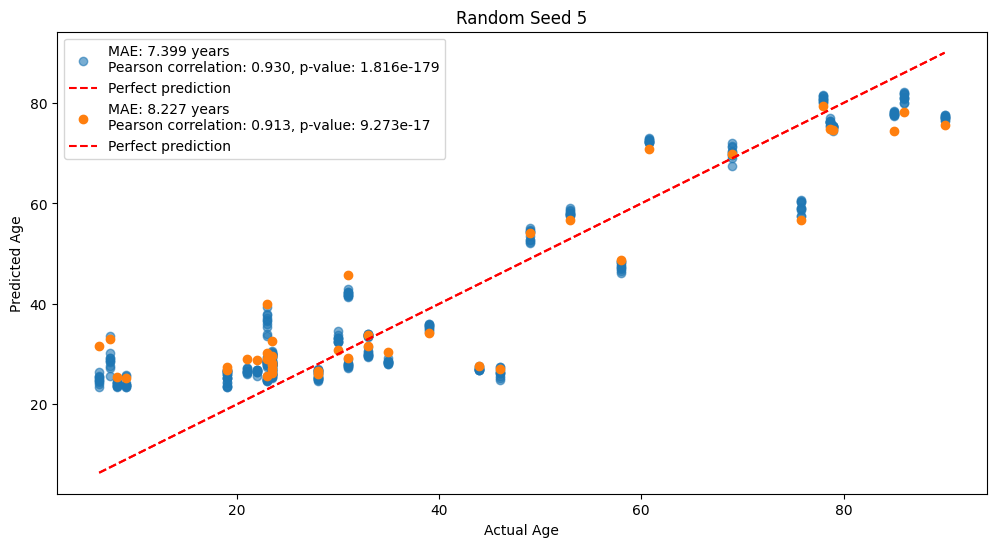

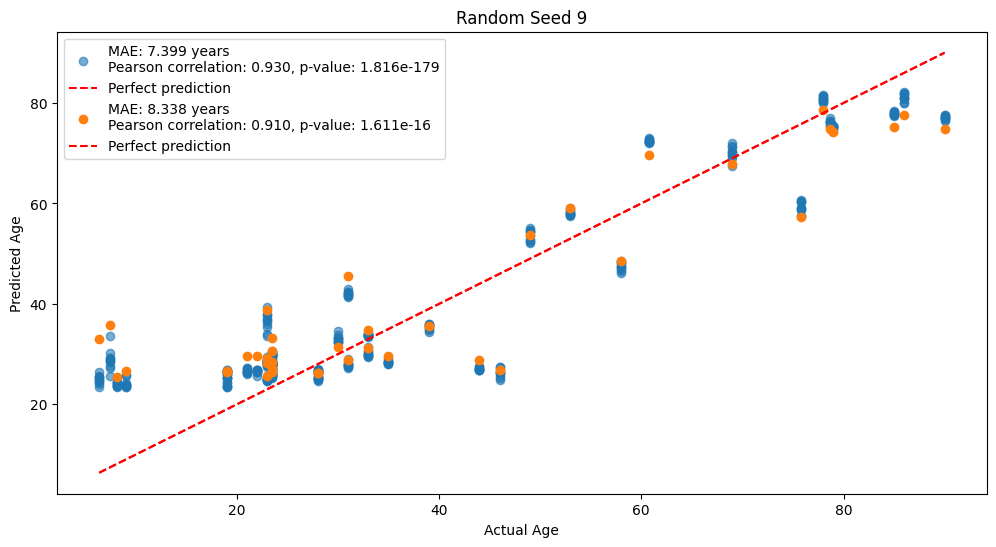

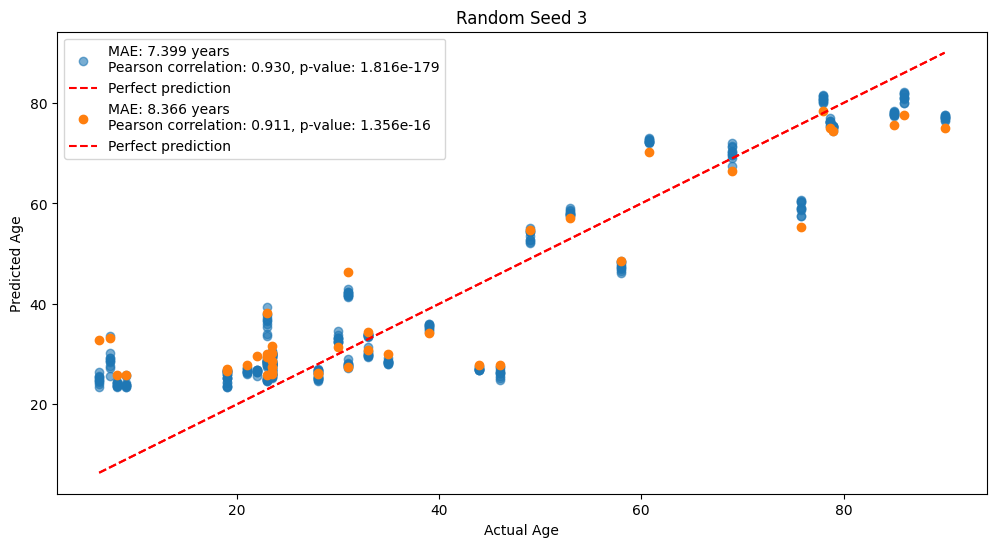

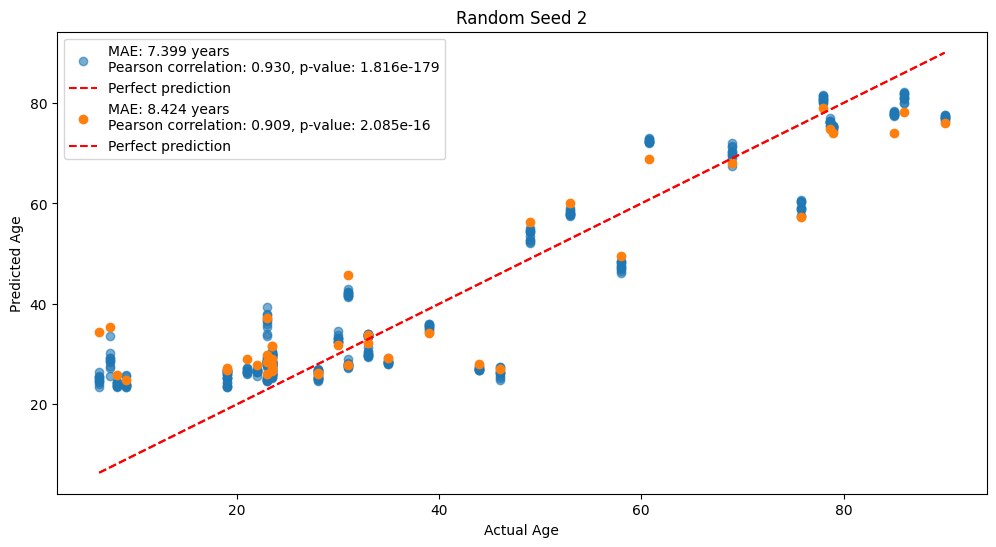

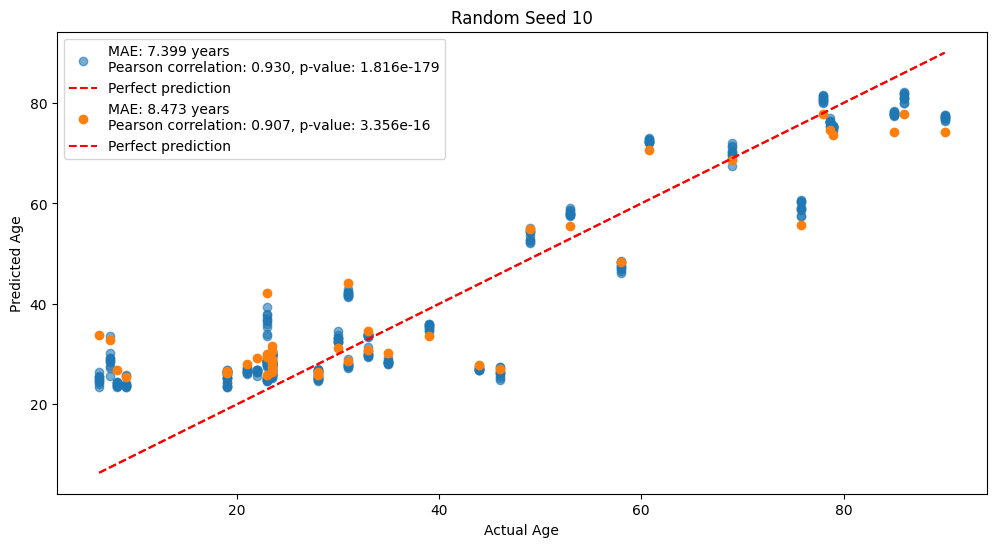

In [6]:
for n in [3,7,0,6,5,4,8,2,1,9]:

    fig, axes = plt.subplots(1,1, figsize=(12,6))

    y_test = np.array(data[10]['y_test']).squeeze()
    y_pred = np.array(data[10]['y_pred']).squeeze()
    mae = mean_absolute_error(y_test, y_pred)
    corr, p_value = pearsonr(y_test, y_pred)

    axes.scatter(y_test, y_pred, alpha=0.6, label=f"MAE: {mae:.3f} years\n" + 
            f"Pearson correlation: {corr:.3f}, p-value: {p_value:.3e}")
    axes.plot([y_test.min(), y_test.max()],
            [y_test.min(), y_test.max()],
            color='red', linestyle='--', label='Perfect prediction')
    axes.set_xlabel('Actual Age')
    axes.set_ylabel('Predicted Age')

    mae = mean_absolute_error(y_test, y_pred)
    corr, p_value = pearsonr(y_test, y_pred)

    y_test = data[1]['y_test'][n]
    y_pred = data[1]['y_pred'][n]
    mae = mean_absolute_error(y_test, y_pred)
    corr, p_value = pearsonr(y_test, y_pred)

    axes.scatter(y_test, y_pred, label=f"MAE: {mae:.3f} years\n" + 
            f"Pearson correlation: {corr:.3f}, p-value: {p_value:.3e}")
    axes.plot([y_test.min(), y_test.max()],
            [y_test.min(), y_test.max()],
            color='red', linestyle='--', label='Perfect prediction')
    axes.set_xlabel('Actual Age')
    axes.set_ylabel('Predicted Age')

    axes.legend(), axes.set_title(f'Random Seed {n+1}');



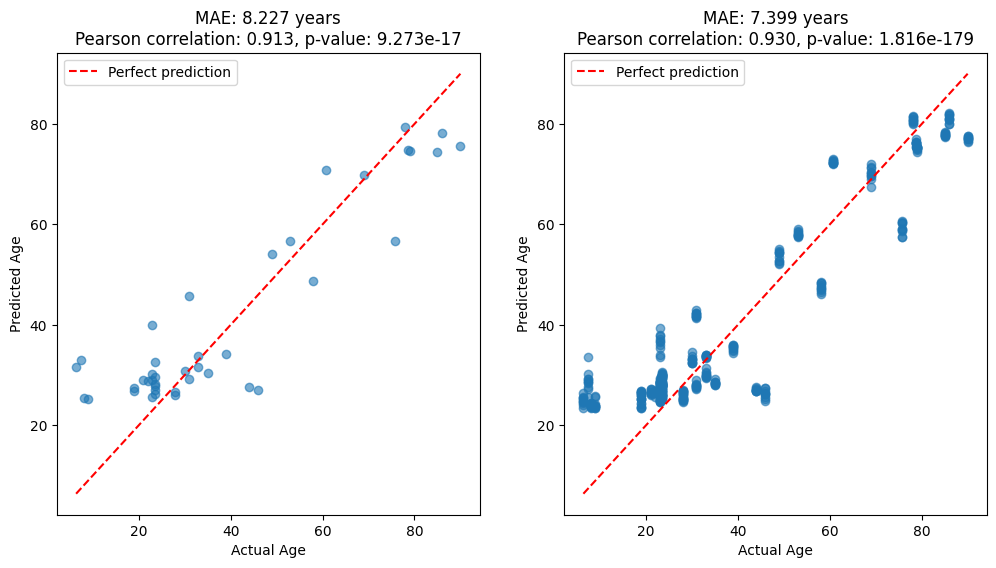

In [ ]:
fig, axes = plt.subplots(1,2, figsize=(12,6))
y_test = data[1]['y_test'][4]
y_pred = data[1]['y_pred'][4]

axes[0].scatter(y_test, y_pred, alpha=0.6)
axes[0].plot([y_test.min(), y_test.max()],
         [y_test.min(), y_test.max()],
         color='red', linestyle='--', label='Perfect prediction')
axes[0].set_xlabel('Actual Age')
axes[0].set_ylabel('Predicted Age')

mae = mean_absolute_error(y_test, y_pred)
corr, p_value = pearsonr(y_test, y_pred)
axes[0].set_title(f"MAE: {mae:.3f} years\n" + 
          f"Pearson correlation: {corr:.3f}, p-value: {p_value:.3e}"
)
axes[0].legend();

y_test = np.array(data[10]['y_test']).squeeze()
y_pred = np.array(data[10]['y_pred']).squeeze()

axes[1].scatter(y_test, y_pred, alpha=0.6)
axes[1].plot([y_test.min(), y_test.max()],
         [y_test.min(), y_test.max()],
         color='red', linestyle='--', label='Perfect prediction')
axes[1].set_xlabel('Actual Age')
axes[1].set_ylabel('Predicted Age')

mae = mean_absolute_error(y_test, y_pred)
corr, p_value = pearsonr(y_test, y_pred)
axes[1].set_title(f"MAE: {mae:.3f} years\n" + 
          f"Pearson correlation: {corr:.3f}, p-value: {p_value:.3e}"
)
axes[1].legend();


# plt.grid(True)

## Dice Loss Per Region
Calculated in `calculate_dice_loss.py`

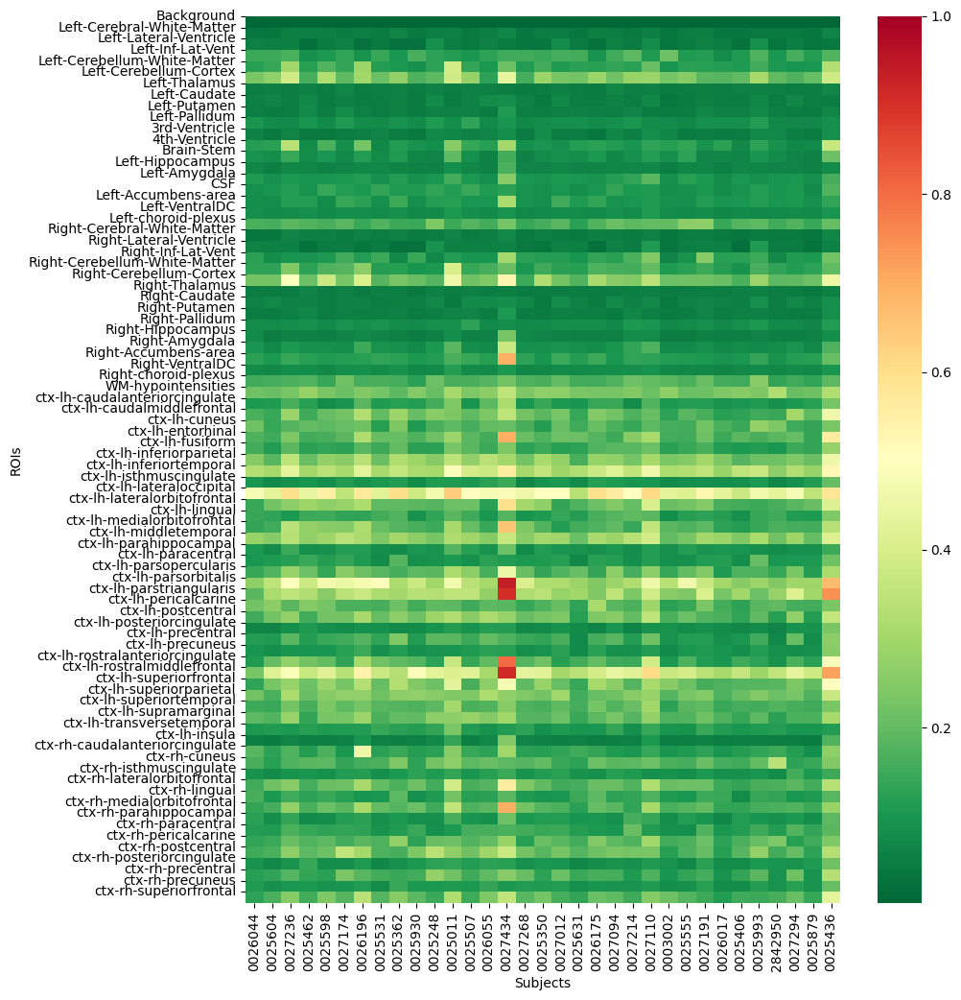

In [15]:
loss_dice = pickle.load(open('dice_loss.pkl', 'rb'))
lut = pd.read_csv("/home/inesgp/cnn_training/FastSurfer_ColorLUT.tsv", delimiter='\t')

df = {}
for sub, losses in loss_dice.items():
    if sub in ['0026036_norm.mgz', '0027393_norm.mgz']: continue
    
    df[sub.split('_')[0]] = np.array(loss_dice[sub]).max(axis=0)

df = pd.DataFrame(df)

plt.figure(figsize=(10,12))
sns.heatmap(df, cmap='RdYlGn_r', vmax=1)
plt.ylabel('ROIs'), plt.xlabel('Subjects')
plt.yticks(np.arange(79), list(lut['LabelName']), rotation=0, fontsize=10);

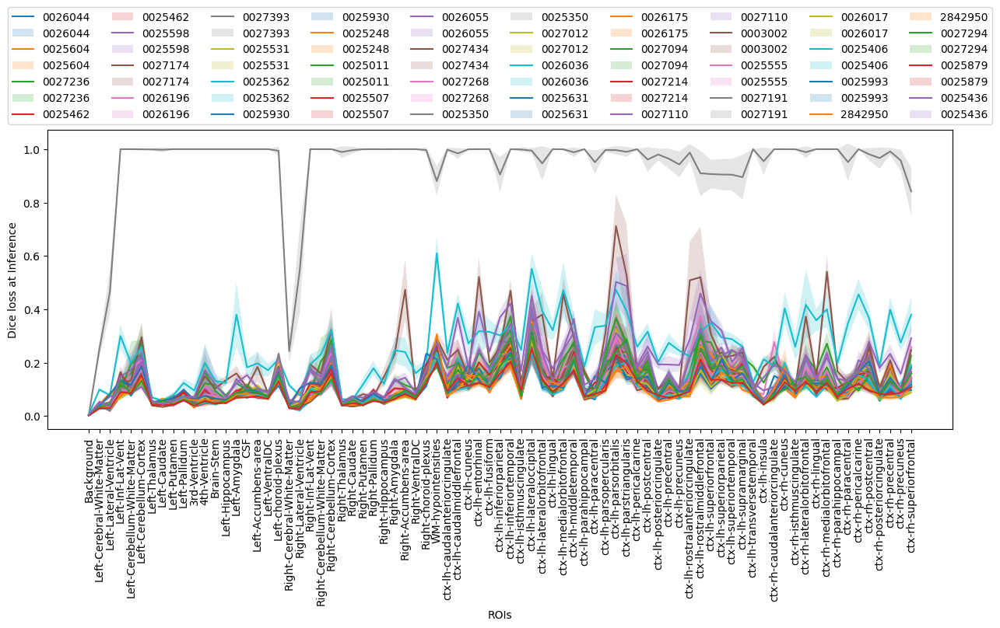

In [12]:

plt.figure(figsize=(15,5))
for sub, losses in loss_dice.items():

    mean = np.array(loss_dice[sub]).mean(axis=0)
    stdev = np.array(loss_dice[sub]).std(axis=0)
    plt.plot(np.arange(len(mean)), mean, label=sub.split('_')[0])
    plt.fill_between(np.arange(len(mean)), mean - stdev, mean + stdev, label=sub.split('_')[0], alpha=0.2, )

plt.xticks(np.arange(79), list(lut['LabelName']), rotation=90)

plt.xlabel('ROIs'), plt.ylabel('Dice loss at Inference'), 
plt.legend(ncol=10, loc='lower center', bbox_to_anchor=(0.5, 1.),);

## Dice Scores

In [2]:
# Load LUT
names = {
    "ID": "int",
    "Label name": "str",
    "Red": "int",
    "Green": "int",
    "Blue": "int",
    "Alpha": "int",
}
lut_path = './data/FreeSurferColorLUT.txt'
df_lut = pd.read_csv(
    lut_path,
    sep='\s+',
    index_col=0,
    skip_blank_lines=True,
    comment="#",
    header=None,
    names=names.keys(),
    dtype=names,
)
df_lut['ID'] = df_lut.index.astype(str)
name_scheme = df_lut.set_index('ID')['Label name'].to_dict()

def pad_list(input_list, n):
    # Check if the length of the list is less than 10
    while len(input_list) < n:
        input_list.append(np.nan)  # Append NaN until the length is 10
    return input_list


def dice_score_aggregator(file_dir, subjects, name_scheme, combs, max_n=45):
    # Aggregate per subject
    aggregated_data_min = {}

    for sub in subjects:
        # if sub in ['ABIDEI_50490', 'ABIDEI_50477', 'ABIDEI_50527', 'ABIDEI_50440']: continue
        aggregated_data = defaultdict(list)

        for i, j in combs:
            json_path = f"{file_dir}{sub}_{i}_{j}.json"
            if not os.path.isfile(json_path):
                # print(f'Missing {sub} {i} {j} json file')
                continue

            with open(json_path, 'r') as f:
                try:
                    data = json.load(f)
                    labels = data['measures']['dice']['labels']
                    if labels:
                        for label, scores in labels.items():
                            aggregated_data[label].append(scores)
                except Exception as e:
                    print(f"Error reading {json_path}: {e}")

        for i in aggregated_data:
            if len(aggregated_data[i]) != max_n: 
                print(sub, i, len(aggregated_data[i]))
                aggregated_data[i] = pad_list(aggregated_data[i], max_n)
            # print( len(aggregated_data[i]), i )

        df = pd.DataFrame(aggregated_data).rename(columns=name_scheme)
        aggregated_data_min[sub] = {col: [df[col].min()] for col in df.columns}
        # except: 
        #     print(sub)
        #     return aggregated_data, aggregated_data_min

    # Compile all subject data
    dice_df = pd.concat([
        pd.DataFrame(v).assign(subjectID=f"{k}")
        for k, v in aggregated_data_min.items()
    ]).set_index("subjectID")

    # dice_df['subjectID'] = dice_df.index

    # dice_df = dice_df.drop('subjectID', axis=1)
    # dice_df = dice_df.reset_index(drop=True)

    dice_df.reset_index(inplace=True)


    dice_df = dice_df.fillna(0)
    
    return dice_df


In [3]:
# List of all ROIs
full_list_of_rois = ['Left-Thalamus', 'ctx-lh-caudalanteriorcingulate', 'ctx-lh-caudalmiddlefrontal', 'ctx-lh-cuneus', 'ctx-lh-entorhinal',
    'ctx-lh-fusiform', 'ctx-lh-inferiorparietal', 'ctx-lh-inferiortemporal', 'ctx-lh-isthmuscingulate', 'ctx-lh-lateraloccipital',
    'ctx-lh-lateralorbitofrontal', 'ctx-lh-lingual', 'ctx-lh-medialorbitofrontal', 'ctx-lh-middletemporal', 'ctx-lh-parahippocampal', 'ctx-lh-paracentral',
    'ctx-lh-parsopercularis', 'ctx-lh-parsorbitalis', 'ctx-lh-parstriangularis', 'ctx-lh-pericalcarine', 'ctx-lh-postcentral',
    'ctx-lh-posteriorcingulate', 'ctx-lh-precentral', 'ctx-lh-precuneus', 'ctx-lh-rostralanteriorcingulate', 'ctx-lh-rostralmiddlefrontal',
    'ctx-lh-superiorfrontal', 'ctx-lh-superiorparietal', 'ctx-lh-superiortemporal', 'ctx-lh-supramarginal', 'ctx-lh-transversetemporal', 'ctx-lh-insula', 'Left-Caudate',
    'Left-Putamen', 'Left-Pallidum', '3rd-Ventricle', '4th-Ventricle', 'Brain-Stem', 'Left-Hippocampus', 'Left-Amygdala', 'Left-Cerebral-White-Matter', 'ctx-rh-caudalanteriorcingulate',
    'ctx-rh-caudalmiddlefrontal', 'ctx-rh-cuneus', 'ctx-rh-entorhinal', 'ctx-rh-fusiform', 'ctx-rh-inferiorparietal', 'ctx-rh-inferiortemporal', 'ctx-rh-isthmuscingulate', 'ctx-rh-lateraloccipital',
    'ctx-rh-lateralorbitofrontal', 'ctx-rh-lingual', 'ctx-rh-medialorbitofrontal', 'ctx-rh-middletemporal', 'ctx-rh-parahippocampal', 'ctx-rh-paracentral', 'ctx-rh-parsopercularis', 'ctx-rh-parsorbitalis',
    'ctx-rh-parstriangularis', 'ctx-rh-pericalcarine', 'ctx-rh-postcentral', 'ctx-rh-posteriorcingulate', 'ctx-rh-precentral', 'ctx-rh-precuneus', 'ctx-rh-rostralanteriorcingulate', 'ctx-rh-rostralmiddlefrontal',
    'ctx-rh-superiorfrontal', 'ctx-rh-superiorparietal', 'ctx-rh-superiortemporal', 'ctx-rh-supramarginal', 'ctx-rh-transversetemporal', 'ctx-rh-insula', 'CSF',
    'Left-Accumbens-area', 'Left-VentralDC', 'Left-choroid-plexus', 'Left-Lateral-Ventricle', 'Right-Cerebral-White-Matter', 'Right-Lateral-Ventricle', 'Right-Inf-Lat-Vent',
    'Right-Cerebellum-White-Matter', 'Right-Cerebellum-Cortex', 'Right-Thalamus', 'Left-Inf-Lat-Vent', 'Right-Caudate', 'Right-Putamen', 'Right-Pallidum', 
    'Right-Hippocampus', 'Right-Amygdala', 'Right-Accumbens-area', 'Right-VentralDC', 'Right-choroid-plexus', 'Left-Cerebellum-White-Matter', 'WM-hypointensities', 'Left-Cerebellum-Cortex'
]

cortical_rois = sorted(['Left-Thalamus', 'Left-Caudate',
    'Left-Putamen', 'Left-Pallidum', '3rd-Ventricle', '4th-Ventricle', 'Brain-Stem', 'Left-Hippocampus', 'Left-Amygdala', 'Left-Cerebral-White-Matter', 'CSF',
    'Left-Accumbens-area', 'Left-VentralDC', 'Left-choroid-plexus', 'Left-Lateral-Ventricle', 'Right-Cerebral-White-Matter', 'Right-Lateral-Ventricle', 'Right-Inf-Lat-Vent',
    'Right-Cerebellum-White-Matter', 'Right-Cerebellum-Cortex', 'Right-Thalamus', 'Left-Inf-Lat-Vent', 'Right-Caudate', 'Right-Putamen', 'Right-Pallidum', 
    'Right-Hippocampus', 'Right-Amygdala', 'Right-Accumbens-area', 'Right-VentralDC', 'Right-choroid-plexus', 'Left-Cerebellum-White-Matter', 'WM-hypointensities', 'Left-Cerebellum-Cortex'
])

cortical_rois_left = sorted(['Left-Thalamus', 'Left-Caudate',
    'Left-Putamen', 'Left-Pallidum', '3rd-Ventricle', '4th-Ventricle', 'Brain-Stem', 'Left-Hippocampus', 'Left-Amygdala', 'Left-Cerebral-White-Matter', 'CSF',
    'Left-Accumbens-area', 'Left-VentralDC', 'Left-choroid-plexus', 'Left-Lateral-Ventricle', 'Left-Inf-Lat-Vent', 'Left-Cerebellum-White-Matter', 'WM-hypointensities', 'Left-Cerebellum-Cortex'
])

subcortical_rois = sorted(['ctx-lh-caudalanteriorcingulate', 'ctx-lh-caudalmiddlefrontal', 'ctx-lh-cuneus', 'ctx-lh-entorhinal',
    'ctx-lh-fusiform', 'ctx-lh-inferiorparietal', 'ctx-lh-inferiortemporal', 'ctx-lh-isthmuscingulate', 'ctx-lh-lateraloccipital',
    'ctx-lh-lateralorbitofrontal', 'ctx-lh-lingual', 'ctx-lh-medialorbitofrontal', 'ctx-lh-middletemporal', 'ctx-lh-parahippocampal', 'ctx-lh-paracentral',
    'ctx-lh-parsopercularis', 'ctx-lh-parsorbitalis', 'ctx-lh-parstriangularis', 'ctx-lh-pericalcarine', 'ctx-lh-postcentral',
    'ctx-lh-posteriorcingulate', 'ctx-lh-precentral', 'ctx-lh-precuneus', 'ctx-lh-rostralanteriorcingulate', 'ctx-lh-rostralmiddlefrontal',
    'ctx-lh-superiorfrontal', 'ctx-lh-superiorparietal', 'ctx-lh-superiortemporal', 'ctx-lh-supramarginal', 'ctx-lh-transversetemporal', 'ctx-lh-insula', 'ctx-rh-caudalanteriorcingulate',
    'ctx-rh-caudalmiddlefrontal', 'ctx-rh-cuneus', 'ctx-rh-entorhinal', 'ctx-rh-fusiform', 'ctx-rh-inferiorparietal', 'ctx-rh-inferiortemporal', 'ctx-rh-isthmuscingulate', 'ctx-rh-lateraloccipital',
    'ctx-rh-lateralorbitofrontal', 'ctx-rh-lingual', 'ctx-rh-medialorbitofrontal', 'ctx-rh-middletemporal', 'ctx-rh-parahippocampal', 'ctx-rh-paracentral', 'ctx-rh-parsopercularis', 'ctx-rh-parsorbitalis',
    'ctx-rh-parstriangularis', 'ctx-rh-pericalcarine', 'ctx-rh-postcentral', 'ctx-rh-posteriorcingulate', 'ctx-rh-precentral', 'ctx-rh-precuneus', 'ctx-rh-rostralanteriorcingulate', 'ctx-rh-rostralmiddlefrontal',
    'ctx-rh-superiorfrontal', 'ctx-rh-superiorparietal', 'ctx-rh-superiortemporal', 'ctx-rh-supramarginal', 'ctx-rh-transversetemporal', 'ctx-rh-insula',
])

subcortical_rois_left = sorted(['ctx-lh-caudalanteriorcingulate', 'ctx-lh-caudalmiddlefrontal', 'ctx-lh-cuneus', 'ctx-lh-entorhinal',
    'ctx-lh-fusiform', 'ctx-lh-inferiorparietal', 'ctx-lh-inferiortemporal', 'ctx-lh-isthmuscingulate', 'ctx-lh-lateraloccipital',
    'ctx-lh-lateralorbitofrontal', 'ctx-lh-lingual', 'ctx-lh-medialorbitofrontal', 'ctx-lh-middletemporal', 'ctx-lh-parahippocampal', 'ctx-lh-paracentral',
    'ctx-lh-parsopercularis', 'ctx-lh-parsorbitalis', 'ctx-lh-parstriangularis', 'ctx-lh-pericalcarine', 'ctx-lh-postcentral',
    'ctx-lh-posteriorcingulate', 'ctx-lh-precentral', 'ctx-lh-precuneus', 'ctx-lh-rostralanteriorcingulate', 'ctx-lh-rostralmiddlefrontal',
    'ctx-lh-superiorfrontal', 'ctx-lh-superiorparietal', 'ctx-lh-superiortemporal', 'ctx-lh-supramarginal', 'ctx-lh-transversetemporal', 'ctx-lh-insula',
])


def graph_mean_dice(full_list_of_rois, df, fig, color, symbol, label, col=1, min=False, legend=True, rois_subset=None):

    long_df = df.melt(id_vars=['subjectID'], var_name='ROI', value_name='Sorensen Dice Scores')

    all_rois = rois_subset if rois_subset is not None else full_list_of_rois    

    # Align Sorensen Dice Scores with all ROIs, filling missing values with NaN
    if min:
        x_values = (
            long_df
            .groupby('ROI')['Sorensen Dice Scores']
            .min()  # Or use another aggregation function like `.max()` or `.first()`
        )
    else:
        x_values = (
            long_df
            .groupby('ROI')['Sorensen Dice Scores']
            .mean()  # Or use another aggregation function like `.max()` or `.first()`
        )

    # Initialize aligned_scores with NaN
    aligned_scores = pd.Series(index=all_rois, data=np.nan)
    # Reindex x_values to match aligned_scores and update
    aligned_scores.update(x_values.reindex(aligned_scores.index))

    jitter_strength = 0.3  # Adjust this value to control jitter amount
    jitter = np.random.uniform(-jitter_strength, jitter_strength, size=len(aligned_scores.values))
    y_numerical, categories = pd.factorize(aligned_scores.index)  # Convert ROI to numerical indices

    y_with_jitter = y_numerical + jitter


    df = pd.DataFrame({'ROI': y_with_jitter, 'Sorensen Dice Score': aligned_scores.values})

    fig.add_trace(
        go.Scatter(
            x=df['Sorensen Dice Score'],
            y=df['ROI'],
            mode='markers',
            marker=dict(
                color=color,
                opacity=0.75,
                size=10,
                symbol=symbol,
            ),
            name=label,
            showlegend=legend,
        ),
        row=1, col=col
    )

    # Update y-axis to display ROI categories
    fig.update_yaxes(
        row=1, col=col,
        tickvals=y_numerical,  # Original numerical indices
        ticktext=categories,  # Corresponding category names
        tickfont=dict(size=20),  # Set the font size for y-axis ticks
        range=[-0.5, max(y_numerical) + 0.5]  # Set fixed range to prevent extra space

    )


def graph_dice(fig, df, rois_subset, color, label, col, legend, significant_rois, box_offset=0.0, jitter_strength=0.2, ):
    # Melt into long format: columns -> 'ROI', values -> 'Dice Score'
    df_melted = df.melt(id_vars='subjectID', var_name='ROI', value_name='Dice Score')

    # # Add asterisk to significant ROIs
    # df_melted['ROI'] = df_melted['ROI'].apply(
    #     lambda x: f"* {x}" if x in significant_rois else x
    # )

    # Ensure consistent order of ROIs
    # rois = sorted([f"* {roi}" if roi in significant_rois else roi for roi in rois_subset])
    rois = sorted(rois_subset)
    df_melted['ROI'] = pd.Categorical(df_melted['ROI'], categories=rois, ordered=True)
    df_melted = df_melted.dropna()
    df_melted = df_melted.sort_values('ROI')

    # Map ROI to numeric positions (for y-axis manipulation)
    roi_to_ypos = {roi: i for i, roi in enumerate(rois)}
    # print(roi_to_ypos)
    # print(df_melted['ROI'])
            
    # Add boxplots per ROI, vertically shifted by `box_offset`
    for roi in rois:
        roi_data = df_melted[df_melted['ROI'] == roi]
        fig.add_trace(
            go.Box(
                x=roi_data['Dice Score'],
                y=[roi_to_ypos[roi] + box_offset] * len(roi_data),
                name=roi,
                orientation='h',
                fillcolor='rgba(0,0,0,0)',
                line=dict(color='black'),
                showlegend=False,
                boxpoints=False,
                hoverinfo='skip'
            ),
            row=1, col=col
        )

    # Add jittered scatter points
    y_jittered = [
        roi_to_ypos[roi] + box_offset + np.random.uniform(-jitter_strength, jitter_strength)
        for roi in df_melted['ROI']
    ]
    

    fig.add_trace(
        go.Scatter(
            x=df_melted['Dice Score'],
            y=y_jittered,
            mode='markers',
            marker=dict(
                color=color,
                opacity=0.75,
                size=6,
            ),
            name=label,
            showlegend=legend,
            text=df_melted['subjectID'],
            hovertemplate='Subject: %{text}<br>Dice: %{x:.3f}<extra></extra>'
        ),
        row=1, col=col
    )

    # # Add horizontal separator lines
    # for i in range(len(rois) - 1):
    #     fig.add_shape(
    #         type='line',
    #         x0=0,
    #         x1=1,
    #         xref='paper',
    #         y0=i + 0.5,
    #         y1=i + 0.5,
    #         yref='y',
    #         line=dict(color='lightgray', width=1),
    #         row=1, col=col
    #     )


    # Add horizontal separator lines only once (if box_offset == 0)
    if box_offset == 0.0:
        for i in range(len(rois) - 1):
            fig.add_shape(
                type='line',
                x0=0,
                x1=1,
                xref='paper',
                y0=i + 0.5,
                y1=i + 0.5,
                yref='y',
                line=dict(color='lightgray', width=1),
                row=1, col=col
            )

    # Update y-axis with tick labels only once (box_offset == 0)
    if box_offset == 0.0:
        fig.update_yaxes(
            tickmode='array',
            tickvals=list(range(len(rois))),
            ticktext=rois,
            row=1, col=col,
            range=[-0.75, len(rois) + 0.75]  # Set fixed range to prevent extra space

        )

    # Add colored asterisks
    # _, yaxis_name = fig.get_subplot(row=1, col=col)  # returns 'y1', 'y2', etc.
    # print(yaxis_name)
    # for roi in rois:
    #     if roi in significant_rois:
    #         fig.add_annotation(
    #             xref='paper', yref=f"y{col}",  # use correct y-axis for subplot
    #             x=0.02, y=roi_to_ypos[roi] + box_offset,
    #             text='*',
    #             showarrow=False,
    #             font=dict(color='red', size=14),
    #             xanchor='right'
    #         )

    for roi in rois:
        if roi in significant_rois:
            fig.add_trace(
                go.Scatter(
                    x=[-0.05],
                    y=[roi_to_ypos[roi] + box_offset],
                    mode='text',
                    text=['*'],
                    textfont=dict(color=color, size=14),
                    showlegend=False,
                    hoverinfo='skip'
                ),
                row=1, col=col
            )


def graph_dice_custommarker(fig, df, rois_subset, color, label, col, legend, significant_rois, box_offset=0.0, jitter_strength=0.2, symbol=None):
    # Melt into long format: columns -> 'ROI', values -> 'Dice Score'
    df_melted = df.melt(id_vars='subjectID', var_name='ROI', value_name='Dice Score')

    # # Add asterisk to significant ROIs
    # df_melted['ROI'] = df_melted['ROI'].apply(
    #     lambda x: f"* {x}" if x in significant_rois else x
    # )

    # Ensure consistent order of ROIs
    # rois = sorted([f"* {roi}" if roi in significant_rois else roi for roi in rois_subset])
    rois = sorted(rois_subset)
    df_melted['ROI'] = pd.Categorical(df_melted['ROI'], categories=rois, ordered=True)
    df_melted = df_melted.dropna()
    df_melted = df_melted.sort_values('ROI')

    # Map ROI to numeric positions (for y-axis manipulation)
    roi_to_ypos = {roi: i for i, roi in enumerate(rois)}
    # print(roi_to_ypos)
    # print(df_melted['ROI'])
            
    # Add boxplots per ROI, vertically shifted by `box_offset`
    for roi in rois:
        roi_data = df_melted[df_melted['ROI'] == roi]
        fig.add_trace(
            go.Box(
                x=roi_data['Dice Score'],
                y=[roi_to_ypos[roi] + box_offset] * len(roi_data),
                name=roi,
                orientation='h',
                fillcolor='rgba(0,0,0,0)',
                line=dict(color='black'),
                showlegend=False,
                boxpoints=False,
                hoverinfo='skip'
            ),
            row=1, col=col
        )

    # Add jittered scatter points
    y_jittered = [
        roi_to_ypos[roi] + box_offset + np.random.uniform(-jitter_strength, jitter_strength)
        for roi in df_melted['ROI']
    ]
    

    fig.add_trace(
        go.Scatter(
            x=df_melted['Dice Score'],
            y=y_jittered,
            mode='markers',
            marker=dict(
                color=color,
                opacity=0.75,
                size=6,
            ),
            name=label,
            showlegend=legend,
            text=df_melted['subjectID'],
            hovertemplate='Subject: %{text}<br>Dice: %{x:.3f}<extra></extra>'
        ),
        row=1, col=col
    )

    # # Add horizontal separator lines
    # for i in range(len(rois) - 1):
    #     fig.add_shape(
    #         type='line',
    #         x0=0,
    #         x1=1,
    #         xref='paper',
    #         y0=i + 0.5,
    #         y1=i + 0.5,
    #         yref='y',
    #         line=dict(color='lightgray', width=1),
    #         row=1, col=col
    #     )


    # Add horizontal separator lines only once (if box_offset == 0)
    if box_offset == 0.0:
        for i in range(len(rois) - 1):
            fig.add_shape(
                type='line',
                x0=0,
                x1=1,
                xref='paper',
                y0=i + 0.5,
                y1=i + 0.5,
                yref='y',
                line=dict(color='lightgray', width=1),
                row=1, col=col
            )

    # Update y-axis with tick labels only once (box_offset == 0)
    if box_offset == 0.0:
        fig.update_yaxes(
            tickmode='array',
            tickvals=list(range(len(rois))),
            ticktext=rois,
            row=1, col=col,
            range=[-0.75, len(rois) + 0.75]  # Set fixed range to prevent extra space

        )

    for roi in rois:
        if roi in significant_rois:
            fig.add_trace(
                go.Scatter(
                    x=[-0.05],
                    y=[roi_to_ypos[roi]],
                    mode='markers',
                    marker=dict(
                        symbol=symbol,
                        size=10,
                        color='black',
                    ),
                    # textfont=dict(color=color, size=14),
                    showlegend=False,
                    hoverinfo='skip'
                ),
                row=1, col=col
            )

### FastSurfer Test Set

In [ ]:
# dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/random_seeds/', 
#                       subjects = os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/2/'),
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))

dice_df = pd.read_csv('./data/dice/rdn_fast_test.csv')

dice_df


IXI_474 5 9
ABIDEI_50527 10 43
ABIDEI_50527 1002 43
ABIDEI_50527 1003 43
ABIDEI_50527 1005 43
ABIDEI_50527 1006 43
ABIDEI_50527 1007 43
ABIDEI_50527 1008 43
ABIDEI_50527 1009 43
ABIDEI_50527 1010 43
ABIDEI_50527 1011 43
ABIDEI_50527 1012 43
ABIDEI_50527 1013 43
ABIDEI_50527 1014 43
ABIDEI_50527 1015 43
ABIDEI_50527 1016 43
ABIDEI_50527 1017 43
ABIDEI_50527 1018 43
ABIDEI_50527 1019 43
ABIDEI_50527 1020 43
ABIDEI_50527 1021 43
ABIDEI_50527 1022 43
ABIDEI_50527 1023 43
ABIDEI_50527 1024 43
ABIDEI_50527 1025 43
ABIDEI_50527 1026 43
ABIDEI_50527 1027 43
ABIDEI_50527 1028 43
ABIDEI_50527 1029 43
ABIDEI_50527 1030 43
ABIDEI_50527 1031 43
ABIDEI_50527 1034 43
ABIDEI_50527 1035 43
ABIDEI_50527 11 43
ABIDEI_50527 12 43
ABIDEI_50527 13 43
ABIDEI_50527 14 43
ABIDEI_50527 15 43
ABIDEI_50527 16 43
ABIDEI_50527 17 43
ABIDEI_50527 18 43
ABIDEI_50527 2 43
ABIDEI_50527 2002 43
ABIDEI_50527 2003 43
ABIDEI_50527 2005 43
ABIDEI_50527 2006 43
ABIDEI_50527 2007 43
ABIDEI_50527 2008 43
ABIDEI_50527 2009 43
A

,subjectID,Left-Thalamus,ctx-lh-caudalanteriorcingulate,ctx-lh-caudalmiddlefrontal,ctx-lh-cuneus,ctx-lh-entorhinal,ctx-lh-fusiform,ctx-lh-inferiorparietal,ctx-lh-inferiortemporal,ctx-lh-isthmuscingulate,...,Right-Putamen,Right-Pallidum,Right-Hippocampus,Right-Amygdala,Right-Accumbens-area,Right-VentralDC,Right-choroid-plexus,Left-Cerebellum-White-Matter,WM-hypointensities,Left-Cerebellum-Cortex
0,HCP_153025,0.976699,0.934915,0.885568,0.904426,0.883348,0.935821,0.954449,0.917880,0.947274,...,0.968197,0.942698,0.974135,0.948677,0.915443,0.957687,0.893551,0.941153,0.874825,0.968280
1,168_S_6350,0.970343,0.943161,0.908674,0.926365,0.902954,0.940304,0.946489,0.927219,0.946755,...,0.958353,0.949022,0.969394,0.951741,0.920103,0.962764,0.895639,0.962433,0.917498,0.972840
2,OAS1_0345,0.974401,0.895982,0.899814,0.938898,0.905257,0.907115,0.950191,0.900693,0.922863,...,0.977013,0.955387,0.966943,0.935867,0.928629,0.953993,0.866097,0.961312,0.888709,0.972257
3,LA5C_50080,0.974417,0.934322,0.934436,0.931376,0.899478,0.934036,0.949783,0.940185,0.954005,...,0.979647,0.962140,0.974069,0.962123,0.949807,0.959085,0.875862,0.972781,0.849612,0.979561
4,IXI_474,0.887332,0.888953,0.863574,0.825690,0.829046,0.869894,0.869603,0.883138,0.853637,...,0.916826,0.894922,0.928945,0.899826,0.804913,0.888982,0.389439,0.878472,0.631821,0.938593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,HCP_188347,0.968158,0.931027,0.916764,0.931866,0.908458,0.897411,0.941951,0.887245,0.953438,...,0.971670,0.942753,0.966698,0.942281,0.913435,0.952106,0.877468,0.952744,0.873840,0.976830
276,941_S_6546,0.973087,0.917805,0.953829,0.916092,0.860323,0.932742,0.945561,0.955665,0.931158,...,0.971965,0.944497,0.968127,0.954672,0.925342,0.943122,0.845994,0.967333,0.916079,0.976587
277,126_S_5243,0.971234,0.921131,0.925325,0.914298,0.909034,0.947519,0.903010,0.915490,0.943353,...,0.966652,0.946361,0.970870,0.945354,0.935764,0.952417,0.902381,0.963320,0.814256,0.972751
278,099_S_6038,0.966384,0.878782,0.889186,0.867536,0.860138,0.876119,0.893409,0.898991,0.933892,...,0.964512,0.937828,0.969697,0.943011,0.912854,0.950576,0.858717,0.954526,0.816817,0.955699


In [19]:
print("Fastsurfer", dice_df.describe().loc['mean'].mean(), dice_df.describe().loc['std'].mean())

Fastsurfer 0.92849639182312 0.02806582747343374


In [8]:
fig = make_subplots(rows=1, cols=2, horizontal_spacing=0.25)
common_x_range = [-0.01, 1.00001]  # or your desired Dice Score range
fig.update_xaxes(range=common_x_range, row=1, col=1)
fig.update_xaxes(range=common_x_range, row=1, col=2)

graph_dice(fig, dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=1, legend=False, significant_rois=[])
graph_dice(fig, dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=2, legend=True, significant_rois=[])

fig.update_layout(
    width=1000,
    height=1500,
    plot_bgcolor='white',
    annotations=[
        dict(
            text="Sorensen Dice Scores",
            x=0.5,
            y=-0.02,
            xref="paper",
            yref="paper",
            showarrow=False,
            font=dict(size=20),
            xanchor='center',
            yanchor='top'
        )
    ],
    showlegend=True,  # Show the legend
    margin=dict(l=10, r=10, t=5, b=50),
    yaxis=dict(tickfont=dict(size=14)),   # y-axis of subplot at (1, 1)
    yaxis2=dict(tickfont=dict(size=14)),  # y-axis of subplot at (1, 2)
    legend=dict(
        orientation="h",  # Set legend to horizontal orientation
        yanchor="bottom",
        y=1.0,  # Position the legend above the figure
        xanchor="center",
        x=0.5,  # Center the legend horizontally
        font=dict(size=20),  # Adjust legend font size
    ),
)


fig.show()


### CoRR

#### Compare 9 epochs to 70 epochs

In [9]:
# rnd_dice_df_epoch9 = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_random_seeds_epoch9/', 
#                       subjects = [x.split('.mgz')[0] for x in os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/')],
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))


# rnd_dice_df_epoch9 = rnd_dice_df_epoch9[rnd_dice_df_epoch9['subjectID'] != '0027393_norm']
# rnd_dice_df_epoch9 = rnd_dice_df_epoch9[rnd_dice_df_epoch9['subjectID'] != '0026036_norm'] #freesurfer fail

# rnd_dice_df_epoch70 = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_random_seeds/', 
#                       subjects = os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/'),
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))


# rnd_dice_df_epoch70 = rnd_dice_df_epoch70[rnd_dice_df_epoch70['subjectID'] != '0027393_norm.mgz']
# rnd_dice_df_epoch70 = rnd_dice_df_epoch70[rnd_dice_df_epoch70['subjectID'] != '0026036_norm.mgz'] #freesurfer fail

rnd_dice_df_epoch70 = pd.read_csv('./data/dice/rdn_fast_corr_epoch70.csv', )
rnd_dice_df_epoch9 = pd.read_csv('./data/dice/rdn_fast_corr_epoch9.csv', )

In [ ]:
fig = make_subplots(rows=1, cols=2, horizontal_spacing=0.25)

graph_dice(fig, rnd_dice_df_epoch9, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed Epoch 9', col=1, legend=True, significant_rois=[], box_offset=0., )
graph_dice(fig, rnd_dice_df_epoch70, rois_subset=cortical_rois, color=px.colors.qualitative.D3[1], label='Random Seed Epoch 70', col=1, legend=True, significant_rois=[], box_offset=-0.15, )


graph_dice(fig, rnd_dice_df_epoch9, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed Epoch 9', col=2, legend=False, significant_rois=[], box_offset=0., )
graph_dice(fig, rnd_dice_df_epoch70, rois_subset=subcortical_rois, color=px.colors.qualitative.D3[1], label='Random Seed Epoch 70', col=2, legend=False, significant_rois=[], box_offset=-0.15, )

# graph_dice(fig, rnd_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=2, legend=False, significant_rois=[], box_offset=0.)
# graph_dice(fig, weights_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations', col=2, legend=False, significant_rois=[], box_offset=-0.15)

# fig.update_layout(height=1500, width=1000)

# # Final layout
fig.update_layout(
    width=1200,
    height=1500,
    plot_bgcolor='white',
    annotations=[
        dict(
            text="Sorensen Dice Scores",
            x=0.5,
            y=-0.02,
            xref="paper",
            yref="paper",
            showarrow=False,
            font=dict(size=20),
            xanchor='center',
            yanchor='top'
        )
    ],
    showlegend=True,  # Show the legend
    margin=dict(l=10, r=10, t=5, b=50),
    yaxis=dict(tickfont=dict(size=14)),   # y-axis of subplot at (1, 1)
    yaxis2=dict(tickfont=dict(size=14)),  # y-axis of subplot at (1, 2)
    legend=dict(
        orientation="h",  # Set legend to horizontal orientation
        yanchor="bottom",
        y=1.0,  # Position the legend above the figure
        xanchor="center",
        x=0.5,  # Center the legend horizontally
        font=dict(size=20),  # Adjust legend font size
    ),
)

fig.show()

#### 9 Epochs

In [12]:
# names = [
#     "dirac", "eye", "identity", "kaiming_normal", "kaiming_uniform",
#     "normal", "ones", "orthogonal", "sparse", "uniform",
#     "xavier_normal", "xavier_uniform", "zeros"
# ]
# weights_dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_weights_epoch9/', 
#                       subjects = [x.split('.mgz')[0] for x in os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/')],
#                       name_scheme=name_scheme, combs=list(combinations(names, 2)), max_n=78)

# weights_dice_df = weights_dice_df[weights_dice_df['subjectID'] != '0027393_norm']
# weights_dice_df = weights_dice_df[weights_dice_df['subjectID'] != '0026036_norm'] #freesurfer fail
 

# rnd_dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_random_seeds_epoch9/', 
#                       subjects = [x.split('.mgz')[0] for x in os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/')],
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))


# rnd_dice_df = rnd_dice_df[rnd_dice_df['subjectID'] != '0027393_norm']
# rnd_dice_df = rnd_dice_df[rnd_dice_df['subjectID'] != '0026036_norm'] #freesurfer fail

# mca_dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_mca_epoch9/', 
#                       subjects = [x.split('.mgz')[0] for x in os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/')],
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))


# mca_dice_df = mca_dice_df[mca_dice_df['subjectID'] != '0027393_norm']
# mca_dice_df = mca_dice_df[mca_dice_df['subjectID'] != '0026036_norm'] #freesurfer fail

freesurfer_dice_df = pd.read_csv('./data/dice/freesurfer_min_dice.csv')
mca_dice_df = pd.read_csv('./data/dice/mca_fast_corr_epoch9.csv', )
weights_dice_df = pd.read_csv('./data/dice/weights_fast_corr_epoch9.csv', )
rnd_dice_df = pd.read_csv('./data/dice/rdn_fast_corr_epoch9.csv', )

In [6]:
print("MCA Fastsurfer", mca_dice_df.describe().loc['mean'].mean(), mca_dice_df.describe().loc['std'].mean())
print("Weight Init Fastsurfer", weights_dice_df.describe().loc['mean'].mean(), weights_dice_df.describe().loc['std'].mean())
print("Random Fastsurfer", rnd_dice_df.describe().loc['mean'].mean(), rnd_dice_df.describe().loc['std'].mean())
print("Freesurfer", freesurfer_dice_df.drop(columns=["subjectID"]).describe().loc['mean'].mean(), freesurfer_dice_df.drop(columns=["subjectID"]).describe().loc['std'].mean())

MCA Fastsurfer 0.7228278015788139 0.07258519115140145
Weight Init Fastsurfer 0.8126690204747316 0.07117209915311483
Random Fastsurfer 0.8118827766165205 0.06468073714622932
Freesurfer 0.8762214997544793 0.03781613866360736


In [8]:
# # Testing whether one ROI group is different from the other
# significant_rois = []
# for col in dice_df.columns:
#     if col == 'subjectID': continue
#     if (stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns)) > 0.001:
#         print(col, stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns), (stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns)) > 0.001 )
#         significant_rois.append(col)



significant_rois = {'Random Seed': [], 'Weight Init': [], 'MCA': []}
rnd_dice_df = rnd_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in rnd_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(rnd_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    # Is Fastsurfer better than Freesurfer (yes if pvalue less than)
    # print(f"One-sided p-value (FastSurfer > FreeSurfer) {col}: {p_value*96:.4e} < 0.05 {p_value*96 < 0.05}")

    if p_value*95 < 0.05: 
        significant_rois['Random Seed'].append(col)

weights_dice_df = weights_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in weights_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(weights_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    if p_value*95 < 0.05: 
        significant_rois['Weight Init'].append(col)

mca_dice_df = mca_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in mca_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(mca_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    if p_value*95 < 0.05: 
        significant_rois['MCA'].append(col)

for name, val in significant_rois.items():
    if name == 'Random Seed':
        print(len(val) , len(rnd_dice_df.columns), len(val)/len(rnd_dice_df.columns))
    elif name == 'MCA':
        print(len(val) , len(mca_dice_df.columns), len(val)/len(mca_dice_df.columns))

    else:
        print(len(val) , len(weights_dice_df.columns), len(val)/len(weights_dice_df.columns))        

13 96 0.13541666666666666
10 96 0.10416666666666667
3 96 0.03125


**WorkShop Figure**

In [17]:
stats.ttest_rel(np.array(mca_dice_df.sort_values(by='subjectID', ascending=True).drop('subjectID',axis=1)).flatten(), 
                np.array(rnd_dice_df.sort_values(by='subjectID', ascending=True).drop('subjectID',axis=1)).flatten() )

TtestResult(statistic=-42.58585808684639, pvalue=4.45150216303e-313, df=3134)

In [24]:
# # Testing whether one ROI group is different from the other
rdn_vs_mca_rois = []
for col in mca_dice_df.columns:
    if col == 'subjectID': continue
    # p value > 0.05 no significant difference
    if (stats.ttest_rel(list(mca_dice_df[col]), list(rnd_dice_df[col]))[1]*95) > 0.05:
        print(col, stats.ttest_rel(list(mca_dice_df[col]), list(rnd_dice_df[col]))[1]*95, (stats.ttest_rel(list(mca_dice_df[col]), list(rnd_dice_df[col]))[1]*95) > 0.05 )
        rdn_vs_mca_rois.append(col)



ctx-lh-middletemporal 14.788217304769772 True
ctx-lh-superiortemporal 4.231643806800547 True
4th-Ventricle 1.3850435395327383 True
Brain-Stem 6.185448573218184 True
ctx-rh-fusiform 56.068280087939016 True
ctx-rh-lateraloccipital 1.7376253533494523 True
ctx-rh-middletemporal 73.76759578760597 True
ctx-rh-pericalcarine 0.15181596409516598 True
Right-Cerebellum-White-Matter 1.1029540425771527 True
Right-Hippocampus 0.8723705559535737 True
Left-Cerebellum-White-Matter 0.12688287071471396 True


In [21]:


significant_rois = {'Better': [], 'Worse': [], }

mca_dice_df = mca_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in mca_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(mca_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='less')

    if p_value*50 < 0.05: 
        significant_rois['Worse'].append(col)

    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    if p_value*50 < 0.05: 
        significant_rois['Better'].append(col)

for name, val in significant_rois.items():

    print(name, len(val) , len(mca_dice_df.columns), len(val)/len(mca_dice_df.columns))


Better 3 96 0.03125
Worse 74 96 0.7708333333333334


In [20]:
len(cortical_rois_left+subcortical_rois_left)

50

In [22]:
fig = make_subplots(rows=1, cols=2, horizontal_spacing=0.25)

graph_dice_custommarker(fig, mca_dice_df, rois_subset=cortical_rois_left, color=px.colors.qualitative.Plotly[1], label='MCA FastSurfer', col=1, legend=True, significant_rois=significant_rois['Better'], box_offset=0., symbol='triangle-up')
graph_dice_custommarker(fig, rnd_dice_df, rois_subset=cortical_rois_left, color=px.colors.qualitative.Plotly[0], label='Random Seed FastSurfer', col=1, legend=True, significant_rois=significant_rois['Worse'], box_offset=-0.2, symbol='triangle-down')
# graph_dice(fig, weights_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations FastSurfer', col=1, legend=True, significant_rois=significant_rois['Weight Init'], box_offset=-0.4, )
graph_dice_custommarker(fig, freesurfer_dice_df, rois_subset=cortical_rois_left, color=px.colors.qualitative.Plotly[8], label='MCA FreeSurfer', col=1, legend=False, significant_rois=[], box_offset=-0.4)


graph_dice_custommarker(fig, mca_dice_df, rois_subset=subcortical_rois_left, color=px.colors.qualitative.Plotly[1], label='MCA FastSurfer', col=2, legend=False, significant_rois=significant_rois['Better'], box_offset=0., symbol='triangle-up')
graph_dice_custommarker(fig, rnd_dice_df, rois_subset=subcortical_rois_left, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=2, legend=False, significant_rois=significant_rois['Worse'], box_offset=-0.2, symbol='triangle-down')
# graph_dice(fig, weights_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations', col=2, legend=False, significant_rois=significant_rois['Weight Init'], box_offset=-0.4)
graph_dice_custommarker(fig, freesurfer_dice_df, rois_subset=subcortical_rois_left, color=px.colors.qualitative.Plotly[8], label='MCA FreeSurfer', col=2, legend=True, significant_rois=[], box_offset=-0.4)

# fig.update_layout(height=1500, width=1000)

# # Final layout
fig.update_layout(
    width=1500,
    height=1500,
    plot_bgcolor='white',
    annotations=[
        dict(
            text="Sorensen Dice Scores",
            x=0.5,
            y=-0.02,
            xref="paper",
            yref="paper",
            showarrow=False,
            font=dict(size=20),
            xanchor='center',
            yanchor='top'
        )
    ],
    showlegend=True,  # Show the legend
    margin=dict(l=10, r=10, t=5, b=50),
    yaxis=dict(tickfont=dict(size=18)),   # y-axis of subplot at (1, 1)
    yaxis2=dict(tickfont=dict(size=18)),  # y-axis of subplot at (1, 2)
    legend=dict(
        orientation="h",  # Set legend to horizontal orientation
        yanchor="bottom",
        y=1.0,  # Position the legend above the figure
        xanchor="center",
        x=0.5,  # Center the legend horizontally
        font=dict(size=20),  # Adjust legend font size
    ),
)

fig.write_image('/home/inesgp/cnn_training/random_fastsurfer_min_dice_epoch9.pdf', engine="kaleido", format='pdf')

fig.show()

**Full Figure**

In [7]:
fig = make_subplots(rows=1, cols=2, horizontal_spacing=0.25)

graph_dice(fig, mca_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[1], label='MCA FastSurfer', col=1, legend=True, significant_rois=significant_rois['MCA'], box_offset=0., )
graph_dice(fig, rnd_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed FastSurfer', col=1, legend=True, significant_rois=significant_rois['Random Seed'], box_offset=-0.2, )
graph_dice(fig, weights_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations FastSurfer', col=1, legend=True, significant_rois=significant_rois['Weight Init'], box_offset=-0.4, )
graph_dice(fig, freesurfer_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[8], label='MCA FreeSurfer', col=1, legend=False, significant_rois=[], box_offset=-0.6)


graph_dice(fig, mca_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[1], label='MCA FastSurfer', col=2, legend=False, significant_rois=significant_rois['MCA'], box_offset=0.)
graph_dice(fig, rnd_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=2, legend=False, significant_rois=significant_rois['Random Seed'], box_offset=-0.2)
graph_dice(fig, weights_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations', col=2, legend=False, significant_rois=significant_rois['Weight Init'], box_offset=-0.4)
graph_dice(fig, freesurfer_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[8], label='MCA FreeSurfer', col=2, legend=True, significant_rois=significant_rois['Random Seed'], box_offset=-0.6)

# fig.update_layout(height=1500, width=1000)

# # Final layout
fig.update_layout(
    width=1500,
    height=1500,
    plot_bgcolor='white',
    annotations=[
        dict(
            text="Sorensen Dice Scores",
            x=0.5,
            y=-0.02,
            xref="paper",
            yref="paper",
            showarrow=False,
            font=dict(size=20),
            xanchor='center',
            yanchor='top'
        )
    ],
    showlegend=True,  # Show the legend
    margin=dict(l=10, r=10, t=5, b=50),
    yaxis=dict(tickfont=dict(size=14)),   # y-axis of subplot at (1, 1)
    yaxis2=dict(tickfont=dict(size=14)),  # y-axis of subplot at (1, 2)
    legend=dict(
        orientation="h",  # Set legend to horizontal orientation
        yanchor="bottom",
        y=1.0,  # Position the legend above the figure
        xanchor="center",
        x=0.5,  # Center the legend horizontally
        font=dict(size=20),  # Adjust legend font size
    ),
)

fig.write_image('/home/inesgp/cnn_training/random_fastsurfer_min_dice_epoch9.pdf', engine="kaleido", format='pdf')

fig.show()

#### 70 Epochs

In [16]:
# names = [
#     "dirac", "eye", "identity", "kaiming_normal", "kaiming_uniform",
#     "normal", "ones", "orthogonal", "sparse", "uniform",
#     "xavier_normal", "xavier_uniform", "zeros"
# ]
# weights_dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_weights/', 
#                       subjects = [x.split('.mgz')[0] for x in os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/')],
#                       name_scheme=name_scheme, combs=list(combinations(names, 2)), max_n=78)

# weights_dice_df = weights_dice_df[weights_dice_df['subjectID'] != '0027393_norm']
# weights_dice_df = weights_dice_df[weights_dice_df['subjectID'] != '0026036_norm'] #freesurfer fail
 
# freesurfer_dice_df = pd.read_csv('/home/inesgp/cnn_training/freesurfer_min_dice.csv')

# rnd_dice_df = dice_score_aggregator(file_dir='/home/inesgp/cnn_training/dice_scores/corr_random_seeds/', 
#                       subjects = os.listdir('/mnt/lustre/vin/fastsurfer_random/FastSurfer/test_results/corr/1/'),
#                       name_scheme=name_scheme, combs=list(combinations(range(1, 10 + 1), 2)))


# rnd_dice_df = rnd_dice_df[rnd_dice_df['subjectID'] != '0027393_norm.mgz']
# rnd_dice_df = rnd_dice_df[rnd_dice_df['subjectID'] != '0026036_norm.mgz'] #freesurfer fail

weights_dice_df = pd.read_csv('./data/dice/weights_fast_corr_epoch70.csv', )
rnd_dice_df = pd.read_csv('./data/dice/rdn_fast_corr_epoch70.csv', )

In [13]:
print("Weight Init Fastsurfer", weights_dice_df.describe().loc['mean'].mean(), weights_dice_df.describe().loc['std'].mean())
print("Random Fastsurfer", rnd_dice_df.describe().loc['mean'].mean(), rnd_dice_df.describe().loc['std'].mean())
print("Freesurfer", freesurfer_dice_df.drop(columns=["subjectID"]).describe().loc['mean'].mean(), freesurfer_dice_df.drop(columns=["subjectID"]).describe().loc['std'].mean())

Weight Init Fastsurfer 0.8372087163147962 0.06472341472233388
Random Fastsurfer 0.8417737148224482 0.057695082751535474


Freesurfer 0.8762214997544793 0.03781613866360736


In [14]:
# # Testing whether one ROI group is different from the other
# significant_rois = []
# for col in dice_df.columns:
#     if col == 'subjectID': continue
#     if (stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns)) > 0.001:
#         print(col, stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns), (stats.ttest_rel(list(dice_df[col]), list(freesurfer_dice_df[col]))[1]*len(dice_df.columns)) > 0.001 )
#         significant_rois.append(col)



significant_rois = {'Random Seed': [], 'Weight Init': []}
rnd_dice_df = rnd_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in rnd_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(rnd_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    # Is Fastsurfer better than Freesurfer (yes if pvalue less than)
    # print(f"One-sided p-value (FastSurfer > FreeSurfer) {col}: {p_value*96:.4e} < 0.05 {p_value*96 < 0.05}")

    if p_value*95 < 0.05: 
        significant_rois['Random Seed'].append(col)

weights_dice_df = weights_dice_df.sort_values(by='subjectID')
freesurfer_dice_df = freesurfer_dice_df.sort_values(by='subjectID')

for col in weights_dice_df.columns:
    if col == 'subjectID': continue

    # Calculate differences
    diffs = [fast - free for fast, free in zip(list(weights_dice_df[col]), list(freesurfer_dice_df[col]))]

    # Perform one-sided paired t-test: H0: mean(diff) <= 0; H1: mean(diff) > 0
    t_stat, p_value = stats.ttest_1samp(diffs, popmean=0, alternative='greater')

    # Is Fastsurfer better than Freesurfer (yes if pvalue less than)
    # print(f"One-sided p-value (FastSurfer > FreeSurfer) {col}: {p_value*96:.4e} < 0.05 {p_value*96 < 0.05}")

    if p_value*95 < 0.05: 
        significant_rois['Weight Init'].append(col)

for name, val in significant_rois.items():
    if name == 'Random Seed':
        print(len(val) , len(rnd_dice_df.columns), len(val)/len(rnd_dice_df.columns))
    else:
        print(len(val) , len(weights_dice_df.columns), len(val)/len(weights_dice_df.columns))        

20 96 0.20833333333333334
16 96 0.16666666666666666


In [15]:
fig = make_subplots(rows=1, cols=2, horizontal_spacing=0.25)

graph_dice(fig, rnd_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed FastSurfer', col=1, legend=True, significant_rois=significant_rois['Random Seed'], box_offset=0., )
graph_dice(fig, weights_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations', col=1, legend=True, significant_rois=significant_rois['Weight Init'], box_offset=-0.15, )
graph_dice(fig, freesurfer_dice_df, rois_subset=cortical_rois, color=px.colors.qualitative.Plotly[1], label='Fuzzy Libmath', col=1, legend=False, significant_rois=[], box_offset=-0.3)


graph_dice(fig, rnd_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[0], label='Random Seed', col=2, legend=False, significant_rois=significant_rois['Random Seed'], box_offset=0.)
graph_dice(fig, weights_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.D3[1], label='Weight Initializations', col=2, legend=False, significant_rois=significant_rois['Weight Init'], box_offset=-0.15)
graph_dice(fig, freesurfer_dice_df, rois_subset=subcortical_rois, color=px.colors.qualitative.Plotly[1], label='Fuzzy Libmath FreeSurfer', col=2, legend=True, significant_rois=significant_rois['Random Seed'], box_offset=-0.3)

# fig.update_layout(height=1500, width=1000)

# # Final layout
fig.update_layout(
    width=1200,
    height=1500,
    plot_bgcolor='white',
    annotations=[
        dict(
            text="Sorensen Dice Scores",
            x=0.5,
            y=-0.02,
            xref="paper",
            yref="paper",
            showarrow=False,
            font=dict(size=20),
            xanchor='center',
            yanchor='top'
        )
    ],
    showlegend=True,  # Show the legend
    margin=dict(l=10, r=10, t=5, b=50),
    yaxis=dict(tickfont=dict(size=14)),   # y-axis of subplot at (1, 1)
    yaxis2=dict(tickfont=dict(size=14)),  # y-axis of subplot at (1, 2)
    legend=dict(
        orientation="h",  # Set legend to horizontal orientation
        yanchor="bottom",
        y=1.0,  # Position the legend above the figure
        xanchor="center",
        x=0.5,  # Center the legend horizontally
        font=dict(size=20),  # Adjust legend font size
    ),
)

fig.write_image('/home/inesgp/cnn_training/random_fastsurfer_min_dice.pdf', engine="kaleido", format='pdf')

fig.show()